# Income Prediction for Addressing Global Income Inequality

## Business Understanding

### Introduction
Income inequality is a pressing issue in developing nations worldwide, exacerbated by the advent of AI and automation. This project aims to leverage machine learning to predict whether an individual's income surpasses or falls below a specific threshold. The goal is to develop a model that not only reduces the cost but also enhances the accuracy of monitoring key population indicators, providing valuable insights for policymakers to mitigate and prevent global income inequality.

### Problem Statement
The growing disparity in income distribution poses a significant challenge, especially in developing nations. Traditional methods of monitoring income levels between census years are costly and may lack accuracy. This project addresses this issue by employing machine learning to predict income levels, offering a more efficient and precise alternative for policymakers.

### Objectives
To create a machine learning model for predicting an individual's income level, thereby aiding policymakers in managing and preventing income inequality globally.

## Analytical Questions:

### Univariate Questions:
* What is the distribution of age in the dataset?

* How is gender distributed among individuals in the dataset?

* What is the most common education level among the individuals?

### Bivariate Question:

* How does education correlate with employment commitment?

### Multivariate Question:
* How does the combination of education, age, and race relate to income levels?

* How does the combination of gender, marital status, and class relate to income levels?

### Hypothesis:
The examined demographic variables  are age, gender, education, class, marital status, race, industry code, occupation code, tax status, and citizenship

* Null hypothesis (H0): there is no association between the examined demographic variables and income levels.

* Alternate hypothesis (H1): there is a significant association between these demographic variables and income distribution.







## Data Understanding

#### Import Necessary libraries

In [1]:
# Load the libraries/modules

# For data manipulation and cleaning
import pandas as pd # a tool for data analysis and manipulation.
import numpy as np # a tool for numerical computations.

# For data visualizations
import matplotlib.pyplot as plt # a tool for ploting graphs/charts.
import seaborn as sns # a tool built on matplotlib for plotting graphs/charts.
import plotly.express as px

# For Statistical testing
# for statistical analysis
# Hypothesis testing
from scipy.stats import chi2_contingency

# For Feature Engineering & ML modeling & Evaluation
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import RandomOverSampler
from sklearn.impute import SimpleImputer # For imputing missing values

from sklearn.metrics import make_scorer, f1_score, accuracy_score, classification_report
from sklearn.model_selection import train_test_split

from sklearn.metrics import accuracy_score,classification_report
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler,LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split

from imblearn.pipeline import Pipeline as ImbPipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder

#import the necessary Classifiers
from catboost import CatBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression



import warnings # Hiding not too major the warnings.
warnings.filterwarnings('ignore')

# Miscellaneous
from termcolor import colored
import pickle
import joblib

### Loading datasets

In [2]:
# Loading train and test datasets

train_data = pd.read_csv('Data/Train (1).csv')

test_data = pd.read_csv('Data/Test.csv')

var_def = pd.read_csv('Data/VariableDefinitions.csv')

In [3]:
#load the variabe definition file
var_def

,Column,Description
0,age,Age Of Individual
1,gender,Gender
2,education,Education
3,class,Class Of Worker
4,education_institute,Enrolled Educational Institution in last week
5,marital_status,Marital_Status
6,race,Race
7,is_hispanic,Hispanic Origin
8,employment_commitment,Full Or Part Time Employment Stat
9,unemployment_reason,Reason For Unemployment


In [4]:
# viewing the head of train data 

train_data.head()

,ID,age,gender,education,class,education_institute,marital_status,race,is_hispanic,employment_commitment,...,country_of_birth_mother,migration_code_change_in_msa,migration_prev_sunbelt,migration_code_move_within_reg,migration_code_change_in_reg,residence_1_year_ago,old_residence_reg,old_residence_state,importance_of_record,income_above_limit
0,ID_TZ0000,79,Female,High school graduate,NaN,NaN,Widowed,White,All other,Not in labor force,...,US,?,?,?,?,NaN,NaN,NaN,1779.74,Below limit
1,ID_TZ0001,65,Female,High school graduate,NaN,NaN,Widowed,White,All other,Children or Armed Forces,...,US,unchanged,NaN,unchanged,unchanged,Same,NaN,NaN,2366.75,Below limit
2,ID_TZ0002,21,Male,12th grade no diploma,Federal government,NaN,Never married,Black,All other,Children or Armed Forces,...,US,unchanged,NaN,unchanged,unchanged,Same,NaN,NaN,1693.42,Below limit
3,ID_TZ0003,2,Female,Children,NaN,NaN,Never married,Asian or Pacific Islander,All other,Children or Armed Forces,...,India,unchanged,NaN,unchanged,unchanged,Same,NaN,NaN,1380.27,Below limit
4,ID_TZ0004,70,Male,High school graduate,NaN,NaN,Married-civilian spouse present,White,All other,Not in labor force,...,US,?,?,?,?,NaN,NaN,NaN,1580.79,Below limit


In [5]:
# viewing the head of the test data
test_data.head()

,ID,age,gender,education,class,education_institute,marital_status,race,is_hispanic,employment_commitment,...,country_of_birth_father,country_of_birth_mother,migration_code_change_in_msa,migration_prev_sunbelt,migration_code_move_within_reg,migration_code_change_in_reg,residence_1_year_ago,old_residence_reg,old_residence_state,importance_of_record
0,ID_TZ209499,54,Male,High school graduate,Private,NaN,Married-civilian spouse present,White,All other,Children or Armed Forces,...,US,US,unchanged,NaN,unchanged,unchanged,Same,NaN,NaN,3388.96
1,ID_TZ209500,53,Male,5th or 6th grade,Private,NaN,Married-civilian spouse present,White,Central or South American,Full-time schedules,...,El-Salvador,El-Salvador,?,?,?,?,NaN,NaN,NaN,1177.55
2,ID_TZ209501,42,Male,Bachelors degree(BA AB BS),Private,NaN,Married-civilian spouse present,White,All other,Full-time schedules,...,US,US,?,?,?,?,NaN,NaN,NaN,4898.55
3,ID_TZ209502,16,Female,9th grade,NaN,High school,Never married,White,All other,Children or Armed Forces,...,US,US,unchanged,NaN,unchanged,unchanged,Same,NaN,NaN,1391.44
4,ID_TZ209503,16,Male,9th grade,NaN,High school,Never married,White,All other,Not in labor force,...,US,US,?,?,?,?,NaN,NaN,NaN,1933.18


In [6]:
# getting the column names in the train data
train_data.columns 

Index(['ID', 'age', 'gender', 'education', 'class', 'education_institute',
       'marital_status', 'race', 'is_hispanic', 'employment_commitment',
       'unemployment_reason', 'employment_stat', 'wage_per_hour',
       'is_labor_union', 'working_week_per_year', 'industry_code',
       'industry_code_main', 'occupation_code', 'occupation_code_main',
       'total_employed', 'household_stat', 'household_summary',
       'under_18_family', 'veterans_admin_questionnaire', 'vet_benefit',
       'tax_status', 'gains', 'losses', 'stocks_status', 'citizenship',
       'mig_year', 'country_of_birth_own', 'country_of_birth_father',
       'country_of_birth_mother', 'migration_code_change_in_msa',
       'migration_prev_sunbelt', 'migration_code_move_within_reg',
       'migration_code_change_in_reg', 'residence_1_year_ago',
       'old_residence_reg', 'old_residence_state', 'importance_of_record',
       'income_above_limit'],
      dtype='object')

In [7]:
# getting the shape of both train and test data
train_data.shape,test_data.shape

((209499, 43), (89786, 42))

In [8]:
# checking for duplicates in both datasets
train_data.duplicated().sum(), test_data.duplicated().sum() 

(0, 0)

In [9]:
#checking for the data information 
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209499 entries, 0 to 209498
Data columns (total 43 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   ID                              209499 non-null  object 
 1   age                             209499 non-null  int64  
 2   gender                          209499 non-null  object 
 3   education                       209499 non-null  object 
 4   class                           104254 non-null  object 
 5   education_institute             13302 non-null   object 
 6   marital_status                  209499 non-null  object 
 7   race                            209499 non-null  object 
 8   is_hispanic                     209499 non-null  object 
 9   employment_commitment           209499 non-null  object 
 10  unemployment_reason             6520 non-null    object 
 11  employment_stat                 209499 non-null  int64  
 12  wage_per_hour   

In [10]:
#checking for the data information 
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 89786 entries, 0 to 89785
Data columns (total 42 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   ID                              89786 non-null  object 
 1   age                             89786 non-null  int64  
 2   gender                          89786 non-null  object 
 3   education                       89786 non-null  object 
 4   class                           44707 non-null  object 
 5   education_institute             5616 non-null   object 
 6   marital_status                  89786 non-null  object 
 7   race                            89786 non-null  object 
 8   is_hispanic                     89786 non-null  object 
 9   employment_commitment           89786 non-null  object 
 10  unemployment_reason             2680 non-null   object 
 11  employment_stat                 89786 non-null  int64  
 12  wage_per_hour                   

#### Checking for missing values in datasets and the percentage missing out of the dataset. 

In [11]:
# Define The datasets
datasets = {'train': train_data, 'test': test_data}

def display_missing_values_info(data, dataset_name):
    title = f"Missing values in the {dataset_name.capitalize()} dataset:"

    # Create an underline of asterisks
    underline = '*' * len(title)
    print(title)
    print(underline)

    # Calculate the sum of missing values for each column
    missing_values = data.isnull().sum()

    # Exclude columns with 0 as missing values
    non_zero_missing_values = missing_values[missing_values > 0]

    # Check if there are any columns with missing values
    if not non_zero_missing_values.empty:

        # Calculate the percentage of missing values
        missing_percentages = ((non_zero_missing_values / len(data)) * 100).round(2)

        # Create a DataFrame with columns sorted by missing values percentage (highest to lowest)
        missing_info = pd.DataFrame({
            'Column': non_zero_missing_values.index,
            'Missing Values': non_zero_missing_values,
            'Missing Values Percentage (%)': missing_percentages
        })

        # Sort the DataFrame by missing values percentage in descending order
        missing_info = missing_info.sort_values(by='Missing Values Percentage (%)', ascending=False)

        # Use to_string to remove index column
        print(missing_info.to_string(index=False))
        print('===' * 26)
    else:
        # If no missing values found, indicate that
        print("No missing values found.")
    print()

# Example usage for train_data
display_missing_values_info(train_data, 'train')

# Example usage for test_data
display_missing_values_info(test_data, 'test')


Missing values in the Train dataset:
************************************
                        Column  Missing Values  Missing Values Percentage (%)
  veterans_admin_questionnaire          207415                          99.01
           unemployment_reason          202979                          96.89
           education_institute          196197                          93.65
             old_residence_reg          193148                          92.20
           old_residence_state          193148                          92.20
                is_labor_union          189420                          90.42
               under_18_family          151654                          72.39
          residence_1_year_ago          106284                          50.73
          occupation_code_main          105694                          50.45
                         class          105245                          50.24
        migration_prev_sunbelt           88452                      

The table provides an overview of the missing information in each column of both the training and test datasets, presenting the count and percentage of missing data for each respective column. This information serves as a valuable guide for data cleaning strategies, helping to inform decisions on whether specific columns should be dropped or if data imputation methods are necessary in order to enhance the overall quality and completeness of the dataset. In both the test and train datasets, veterans_admin_questionnaire had the highest count and percentage of missing value whiles migration_code_change_in_reg was one of the columns to have the least count and percentage. 

In [12]:
# Check for number of unique values in each columns 
train_uni_vals = train_data.nunique()

for column, count in train_uni_vals.items():
    print(f"Column: {column}, Unique values: {count}")

Column: ID, Unique values: 209499
Column: age, Unique values: 91
Column: gender, Unique values: 2
Column: education, Unique values: 17
Column: class, Unique values: 8
Column: education_institute, Unique values: 2
Column: marital_status, Unique values: 7
Column: race, Unique values: 5
Column: is_hispanic, Unique values: 10
Column: employment_commitment, Unique values: 8
Column: unemployment_reason, Unique values: 5
Column: employment_stat, Unique values: 3
Column: wage_per_hour, Unique values: 1232
Column: is_labor_union, Unique values: 2
Column: working_week_per_year, Unique values: 53
Column: industry_code, Unique values: 52
Column: industry_code_main, Unique values: 24
Column: occupation_code, Unique values: 47
Column: occupation_code_main, Unique values: 14
Column: total_employed, Unique values: 7
Column: household_stat, Unique values: 38
Column: household_summary, Unique values: 8
Column: under_18_family, Unique values: 4
Column: veterans_admin_questionnaire, Unique values: 2
Colum

In [13]:
# checking for unique inputs in employment_commitment column
train_data['employment_commitment'].unique() # this code was used to check for unique values in each column to give ideas on what columns to work with


array([' Not in labor force', ' Children or Armed Forces',
       ' Full-time schedules', ' PT for econ reasons usually PT',
       ' Unemployed full-time', ' PT for non-econ reasons usually FT',
       ' PT for econ reasons usually FT', ' Unemployed part- time'],
      dtype=object)

### Dropping columns that are not relevant to this analysis 

In [14]:
# Define the columns to drop
columns_to_drop = ['ID','education_institute','unemployment_reason', 'employment_stat', 'is_labor_union', 'industry_code', 'occupation_code', 'total_employed', 'household_stat', 'household_summary', 'under_18_family', 'veterans_admin_questionnaire', 'vet_benefit', 'gains', 'losses', 'stocks_status', 'mig_year', 'country_of_birth_own', 'country_of_birth_father', 'country_of_birth_mother', 'migration_code_change_in_msa', 'migration_prev_sunbelt', 'migration_code_move_within_reg', 'migration_code_change_in_reg', 'residence_1_year_ago', 'old_residence_reg', 'old_residence_state', 'importance_of_record']

# Create a new DataFrame with the specified columns dropped
new_train = train_data.drop(columns=columns_to_drop).copy()


Columns containing more than 70% missing values were removed from the dataset to prevent the generation of inaccurate or misleading conclusions, given that the missing values in these columns were not sufficiently represented in the dataset.

#### Test dataset

In [15]:
# Copy the 'ID' column to original_ids_df(to be used later)
original_ids_df = test_data[['ID']].copy()

In [16]:
# Define the columns to drop
columns_to_drop = ['ID','education_institute','unemployment_reason', 'employment_stat', 'is_labor_union', 'industry_code', 'occupation_code', 'total_employed', 'household_stat', 'household_summary', 'under_18_family', 'veterans_admin_questionnaire', 'vet_benefit', 'gains', 'losses', 'stocks_status', 'mig_year', 'country_of_birth_own', 'country_of_birth_father', 'country_of_birth_mother', 'migration_code_change_in_msa', 'migration_prev_sunbelt', 'migration_code_move_within_reg', 'migration_code_change_in_reg', 'residence_1_year_ago', 'old_residence_reg', 'old_residence_state', 'importance_of_record']

# Create a new DataFrame with the specified columns dropped
new_test = test_data.drop(columns=columns_to_drop).copy()

##### Cleaning continuation

In [17]:
#viewing the head of df_train
new_train .head()

,age,gender,education,class,marital_status,race,is_hispanic,employment_commitment,wage_per_hour,working_week_per_year,industry_code_main,occupation_code_main,tax_status,citizenship,income_above_limit
0,79,Female,High school graduate,NaN,Widowed,White,All other,Not in labor force,0,52,Not in universe or children,NaN,Head of household,Native,Below limit
1,65,Female,High school graduate,NaN,Widowed,White,All other,Children or Armed Forces,0,0,Not in universe or children,NaN,Single,Native,Below limit
2,21,Male,12th grade no diploma,Federal government,Never married,Black,All other,Children or Armed Forces,500,15,Hospital services,Adm support including clerical,Single,Native,Below limit
3,2,Female,Children,NaN,Never married,Asian or Pacific Islander,All other,Children or Armed Forces,0,0,Not in universe or children,NaN,Nonfiler,Native,Below limit
4,70,Male,High school graduate,NaN,Married-civilian spouse present,White,All other,Not in labor force,0,0,Not in universe or children,NaN,Joint both 65+,Native,Below limit


In [18]:
# checking for information in the new training data 
new_train .info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209499 entries, 0 to 209498
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   age                    209499 non-null  int64 
 1   gender                 209499 non-null  object
 2   education              209499 non-null  object
 3   class                  104254 non-null  object
 4   marital_status         209499 non-null  object
 5   race                   209499 non-null  object
 6   is_hispanic            209499 non-null  object
 7   employment_commitment  209499 non-null  object
 8   wage_per_hour          209499 non-null  int64 
 9   working_week_per_year  209499 non-null  int64 
 10  industry_code_main     209499 non-null  object
 11  occupation_code_main   103805 non-null  object
 12  tax_status             209499 non-null  object
 13  citizenship            209499 non-null  object
 14  income_above_limit     209499 non-null  object
dtype

In [19]:
#viewing the head of new test data
new_test.head()

,age,gender,education,class,marital_status,race,is_hispanic,employment_commitment,wage_per_hour,working_week_per_year,industry_code_main,occupation_code_main,tax_status,citizenship
0,54,Male,High school graduate,Private,Married-civilian spouse present,White,All other,Children or Armed Forces,600,46,Transportation,Transportation and material moving,Joint both under 65,Native
1,53,Male,5th or 6th grade,Private,Married-civilian spouse present,White,Central or South American,Full-time schedules,0,52,Manufacturing-durable goods,Machine operators assmblrs & inspctrs,Joint both under 65,Foreign born- Not a citizen of U S
2,42,Male,Bachelors degree(BA AB BS),Private,Married-civilian spouse present,White,All other,Full-time schedules,0,44,Business and repair services,Professional specialty,Joint both under 65,Native
3,16,Female,9th grade,NaN,Never married,White,All other,Children or Armed Forces,0,8,Not in universe or children,NaN,Single,Native
4,16,Male,9th grade,NaN,Never married,White,All other,Not in labor force,0,0,Not in universe or children,NaN,Nonfiler,Native


In [20]:
# checking for info
new_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 89786 entries, 0 to 89785
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   age                    89786 non-null  int64 
 1   gender                 89786 non-null  object
 2   education              89786 non-null  object
 3   class                  44707 non-null  object
 4   marital_status         89786 non-null  object
 5   race                   89786 non-null  object
 6   is_hispanic            89786 non-null  object
 7   employment_commitment  89786 non-null  object
 8   wage_per_hour          89786 non-null  int64 
 9   working_week_per_year  89786 non-null  int64 
 10  industry_code_main     89786 non-null  object
 11  occupation_code_main   44513 non-null  object
 12  tax_status             89786 non-null  object
 13  citizenship            89786 non-null  object
dtypes: int64(3), object(11)
memory usage: 9.6+ MB


In [21]:
#checking for missing values in both new datasets (train and test)
# Define The datasets
datasets = {'train': new_train , 'test': new_test}

def display_missing_values_info(data, dataset_name):
    title = f"Missing values in the {dataset_name.capitalize()} dataset:"

    # Create an underline of asterisks
    underline = '*' * len(title)
    print(title)
    print(underline)

    # Calculate the sum of missing values for each column
    missing_values = data.isnull().sum()

    # Exclude columns with 0 as missing values
    non_zero_missing_values = missing_values[missing_values > 0]

    # Check if there are any columns with missing values
    if not non_zero_missing_values.empty:

        # Calculate the percentage of missing values
        missing_percentages = ((non_zero_missing_values / len(data)) * 100).round(2)

        # Create a DataFrame with columns sorted by missing values percentage (highest to lowest)
        missing_info = pd.DataFrame({
            'Column': non_zero_missing_values.index,
            'Missing Values': non_zero_missing_values,
            'Missing Values Percentage (%)': missing_percentages
        })

        # Sort the DataFrame by missing values percentage in descending order
        missing_info = missing_info.sort_values(by='Missing Values Percentage (%)', ascending=False)

        # Use to_string to remove index column
        print(missing_info.to_string(index=False))
        print('===' * 26)
    else:
        # If no missing values found, indicate that
        print("No missing values found.")
    print()

# Example usage for train_data
display_missing_values_info(new_train , 'train')

# Example usage for test_data
display_missing_values_info(new_test, 'test')


Missing values in the Train dataset:
************************************
              Column  Missing Values  Missing Values Percentage (%)
occupation_code_main          105694                          50.45
               class          105245                          50.24

Missing values in the Test dataset:
***********************************
              Column  Missing Values  Missing Values Percentage (%)
occupation_code_main           45273                          50.42
               class           45079                          50.21



In [22]:
# Checking for the unique inputs in the columns which had missing values for bothe test and train datasets 
columns_with_missing_values = ['occupation_code_main','class']
def print_unique_values_for_missing(data, columns_with_missing):
    for column in columns_with_missing:
        unique_values = data[column].unique()
        print(f"Unique values in '{column}':")
        print(unique_values)
        print('=' * 75)

# Example usage for new_train with columns_with_missing_values
print_unique_values_for_missing(new_train , columns_with_missing_values)


Unique values in 'occupation_code_main':
[nan ' Adm support including clerical' ' Other service'
 ' Executive admin and managerial' ' Sales'
 ' Machine operators assmblrs & inspctrs'
 ' Precision production craft & repair' ' Professional specialty'
 ' Handlers equip cleaners etc ' ' Transportation and material moving'
 ' Farming forestry and fishing' ' Private household services'
 ' Technicians and related support' ' Protective services' ' Armed Forces']
Unique values in 'class':
[nan ' Federal government' ' Private' ' Local government'
 ' Self-employed-incorporated' ' Self-employed-not incorporated'
 ' State government' ' Without pay' ' Never worked']


### Handling Missing Values in both Train and Test datasets 

##### Train data

Inputs in the columns with missing values are categorical hence we use the most frequent strategy to fill the nan values 

In [23]:
# Define columns with missing values
columns_with_missing_values = ['occupation_code_main', 'class']

# Create a SimpleImputer instance for categorical columns (assuming these columns are categorical)
categorical_imputer = SimpleImputer(strategy='most_frequent')

# Impute missing values for categorical columns
new_train [columns_with_missing_values] = categorical_imputer.fit_transform(new_train [columns_with_missing_values])


In [24]:
# creating a map for the education column to change the names of the input in the train dataset

education_mapping = {
    ' High school graduate': 'High School Graduate',
    ' 12th grade no diploma': '12th Grade No Diploma',
    ' Children': 'Children',
    ' Bachelors degree(BA AB BS)': 'Bachelors Degree',
    ' Masters degree(MA MS MEng MEd MSW MBA)': 'Masters Degree',
    ' Associates degree-academic program': 'Associates Degree (Academic Program)',
    ' Associates degree-occup /vocational': 'Associates Degree (Occupational/Vocational)',
    ' Prof school degree (MD DDS DVM LLB JD)': 'Professional School Degree',
    ' Some college but no degree': 'Some College (No Degree)',
    ' Less than 1st grade': 'Less than 1st Grade',
    ' 9th grade': '9th Grade',
    ' 10th grade': '10th Grade',
    ' 11th grade': '11th Grade',
    ' 7th and 8th grade': '7th and 8th Grade',
    ' 5th or 6th grade': '5th or 6th Grade',
    ' Doctorate degree(PhD EdD)':'Doctorate Degree',
    ' 1st 2nd 3rd or 4th grade':' 1st 2nd 3rd or 4th Grade'
}

# Map the education levels
new_train['education'] = new_train['education'].map(education_mapping)



In [25]:
# Renaming the column class to working class
new_train.rename(columns={'class': 'work_class'}, inplace=True)

In [26]:
# we drop columns based on knowledge gain and keep the ones below
 
columns_to_keep = [
    'age', 'gender', 'education', 'work_class', 'marital_status',
    'race', 'is_hispanic', 'employment_commitment', 'wage_per_hour',
    'working_week_per_year', 'industry_code_main', 'occupation_code_main',
    'tax_status', 'citizenship','income_above_limit'
]

# Convert string values to lowercase for the specified columns
new_train[columns_to_keep] = new_train[columns_to_keep].applymap(lambda x: x.lower() if isinstance(x, str) else x)

The columns kept were based on the general pre-employment and salary allocation checks done in companies. **Ref:**https://enterprise.gov.ie/en/what-we-do/workplace-and-skills/employment-permits/permit-types/general-employment-permit/ . 

In [27]:
# checking for information in the new train dataset
new_train .info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209499 entries, 0 to 209498
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   age                    209499 non-null  int64 
 1   gender                 209499 non-null  object
 2   education              209499 non-null  object
 3   work_class             209499 non-null  object
 4   marital_status         209499 non-null  object
 5   race                   209499 non-null  object
 6   is_hispanic            209499 non-null  object
 7   employment_commitment  209499 non-null  object
 8   wage_per_hour          209499 non-null  int64 
 9   working_week_per_year  209499 non-null  int64 
 10  industry_code_main     209499 non-null  object
 11  occupation_code_main   209499 non-null  object
 12  tax_status             209499 non-null  object
 13  citizenship            209499 non-null  object
 14  income_above_limit     209499 non-null  object
dtype

In [28]:
# viewing the head 
new_train .head()

,age,gender,education,work_class,marital_status,race,is_hispanic,employment_commitment,wage_per_hour,working_week_per_year,industry_code_main,occupation_code_main,tax_status,citizenship,income_above_limit
0,79,female,high school graduate,private,widowed,white,all other,not in labor force,0,52,not in universe or children,adm support including clerical,head of household,native,below limit
1,65,female,high school graduate,private,widowed,white,all other,children or armed forces,0,0,not in universe or children,adm support including clerical,single,native,below limit
2,21,male,12th grade no diploma,federal government,never married,black,all other,children or armed forces,500,15,hospital services,adm support including clerical,single,native,below limit
3,2,female,children,private,never married,asian or pacific islander,all other,children or armed forces,0,0,not in universe or children,adm support including clerical,nonfiler,native,below limit
4,70,male,high school graduate,private,married-civilian spouse present,white,all other,not in labor force,0,0,not in universe or children,adm support including clerical,joint both 65+,native,below limit


##### Test data

Same strategy used for the train dataset is used on the test dataset

In [29]:
# Renaming the column class to working class
new_test.rename(columns={'class': 'work_class'}, inplace=True)

In [30]:
# Define columns with missing values
columns_with_missing_values = ['occupation_code_main', 'work_class']

# Create a SimpleImputer instance for categorical columns (assuming these columns are categorical)
categorical_imputer = SimpleImputer(strategy='most_frequent')

# Impute missing values for categorical columns
new_test[columns_with_missing_values] = categorical_imputer.fit_transform(new_test[columns_with_missing_values])

In [31]:
# Create a map for renaming the inputs in the education column 
education_mapping = {
    ' High school graduate': 'High School Graduate',
    ' 12th grade no diploma': '12th Grade No Diploma',
    ' Children': 'Children',
    ' Bachelors degree(BA AB BS)': 'Bachelors Degree',
    ' Masters degree(MA MS MEng MEd MSW MBA)': 'Masters Degree',
    ' Associates degree-academic program': 'Associates Degree (Academic Program)',
    ' Associates degree-occup /vocational': 'Associates Degree (Occupational/Vocational)',
    ' Prof school degree (MD DDS DVM LLB JD)': 'Professional School Degree',
    ' Some college but no degree': 'Some College (No Degree)',
    ' Less than 1st grade': 'Less than 1st Grade',
    ' 9th grade': '9th Grade',
    ' 10th grade': '10th Grade',
    ' 11th grade': '11th Grade',
    ' 7th and 8th grade': '7th and 8th Grade',
    ' 5th or 6th grade': '5th or 6th Grade',
    ' Doctorate degree(PhD EdD)':'Doctorate Degree',
    ' 1st 2nd 3rd or 4th grade':' 1st 2nd 3rd or 4th Grade'
}

# Map the education levels
new_test['education'] = new_test['education'].map(education_mapping)

In [32]:
# we drop columns based on knowledge gain and keep the ones below
 
columns_to_keep = [
    'age', 'gender', 'education', 'work_class', 'marital_status',
    'race', 'is_hispanic', 'employment_commitment', 'wage_per_hour',
    'working_week_per_year', 'industry_code_main', 'occupation_code_main',
    'tax_status', 'citizenship'
]

# Convert string values to lowercase for the specified columns
new_test[columns_to_keep] = new_test[columns_to_keep].applymap(lambda x: x.lower() if isinstance(x, str) else x)

In [33]:
new_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 89786 entries, 0 to 89785
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   age                    89786 non-null  int64 
 1   gender                 89786 non-null  object
 2   education              89786 non-null  object
 3   work_class             89786 non-null  object
 4   marital_status         89786 non-null  object
 5   race                   89786 non-null  object
 6   is_hispanic            89786 non-null  object
 7   employment_commitment  89786 non-null  object
 8   wage_per_hour          89786 non-null  int64 
 9   working_week_per_year  89786 non-null  int64 
 10  industry_code_main     89786 non-null  object
 11  occupation_code_main   89786 non-null  object
 12  tax_status             89786 non-null  object
 13  citizenship            89786 non-null  object
dtypes: int64(3), object(11)
memory usage: 9.6+ MB


#### General Descriptive Analysis on the numeric features of the dataset

In [34]:
new_train .describe()

,age,wage_per_hour,working_week_per_year
count,209499.000000,209499.000000,209499.000000
mean,34.518728,55.433487,23.158850
std,22.306738,276.757327,24.397963
min,0.000000,0.000000,0.000000
25%,15.000000,0.000000,0.000000
50%,33.000000,0.000000,8.000000
75%,50.000000,0.000000,52.000000
max,90.000000,9999.000000,52.000000


The table summarizes the statistics for three columns: age, wage_per_hour, and working_week_per_year. It shows the count, mean, standard deviation, minimum, 25th percentile (Q1), median (50th percentile or Q2), 75th percentile (Q3), and maximum values for each column. Specifically, the average age is approximately 34.5 years, the average wage per hour is around 55.43, and the average working weeks per year is approximately 23.16.

### Class Distribution 

This is to understand the distribution of the target value in the dataset and help identify class imbalance and also how to resolve it. 

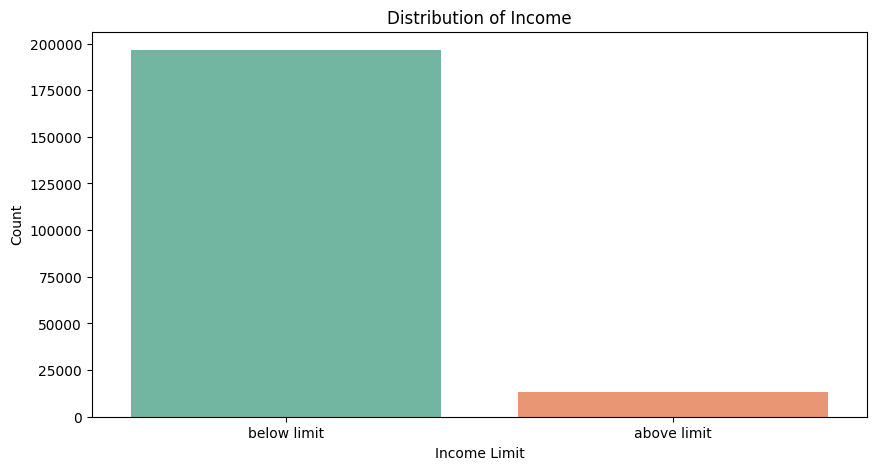

Insights for the Distribution of Income:
- There are 12998 participants with income above $50k (Above Limit) and 196501 below $50k (Below Limit).
- The dataset exhibits a significant imbalance between the targets, with a much larger number below the $50k income limit.


In [35]:
# Plot the distribution of the target column 'income_above_limit' with a different color palette
plt.figure(figsize=(10, 5))
sns.countplot(data=new_train , x='income_above_limit', palette='Set2')
plt.title('Distribution of Income')
plt.xlabel('Income Limit')
plt.ylabel('Count')
plt.show()

# Deductions based on the distribution
income_counts = new_train ['income_above_limit'].value_counts()

# Print insights about the distribution of income
print("Insights for the Distribution of Income:")
print(f"- There are {income_counts[1]} participants with income above $50k (Above Limit) and {income_counts[0]} below $50k (Below Limit).")
print("- The dataset exhibits a significant imbalance between the targets, with a much larger number below the $50k income limit.")


In [36]:
# Creating a copies of df_train for hypothesis testing 
hyp_train = new_train.copy()


## Answering Analytical Questions and Hypothesis

### Univariate Analysis

* What is the distribution of age in the dataset?


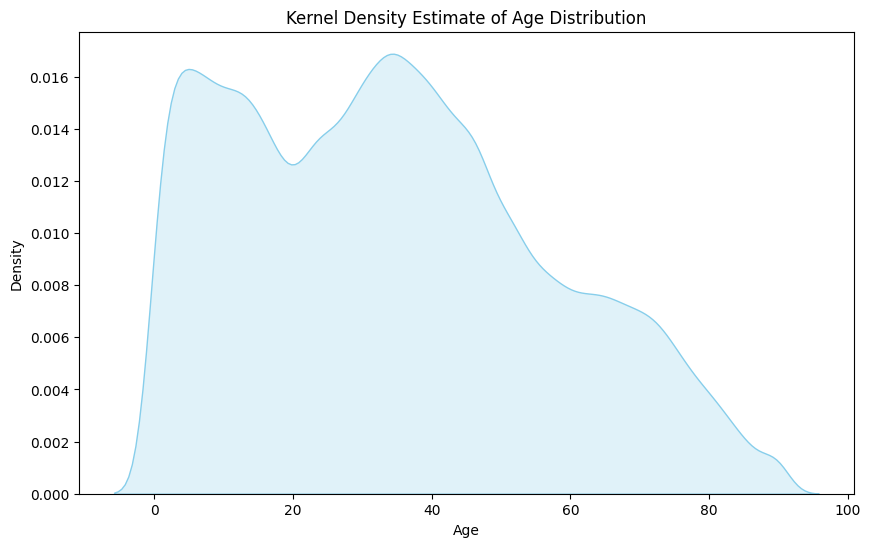

In [37]:
# a KDE plot to visualize the probability density of the age distribution

#  KDE plot for the 'age' column
plt.figure(figsize=(10, 6))
sns.kdeplot(new_train ['age'], fill=True, color='skyblue')
plt.title('Kernel Density Estimate of Age Distribution')
plt.xlabel('Age')
plt.ylabel('Density')
plt.show()


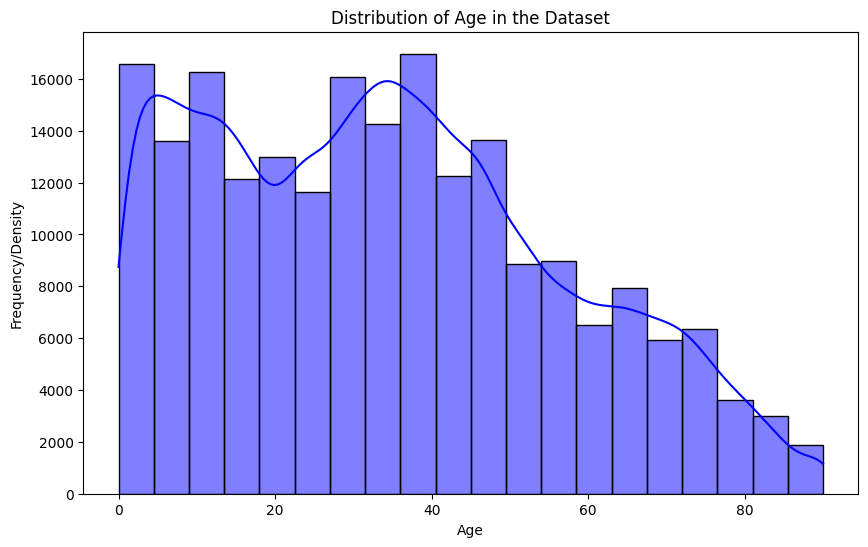

In [38]:
# Set up the figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

# Plot histogram with KDE
sns.histplot(new_train ['age'], bins=20, kde=True, color='blue', ax=ax)

# Set labels and title
ax.set_title('Distribution of Age in the Dataset')
ax.set_xlabel('Age')
ax.set_ylabel('Frequency/Density')

# Show the plot
plt.show()


Kernel Density Estimation (KDE) is a tool that helps us draw a smooth curve to show how ages are distributed or spread out. Looking at the graphs above, it can be seen that there are more young people in the dataset, with a significant number falling within the age ranges of 0-20 and 20-40 years.

* How is gender distributed among individuals in the dataset?

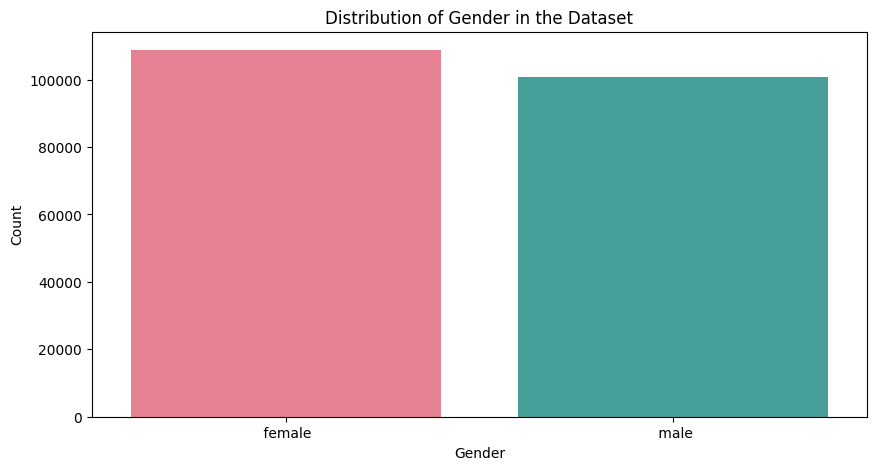

Insights for the Distribution of Gender:
-  female: 51.93%
-  male: 48.07%


In [39]:
# Plot the distribution of gender
plt.figure(figsize=(10, 5))
sns.countplot(data=new_train , x='gender', palette='husl')
plt.title('Distribution of Gender in the Dataset')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.show()

# Calculate percentage of each gender
gender_distribution = new_train['gender'].value_counts(normalize=True) * 100

# Print insights about the distribution of gender
print("Insights for the Distribution of Gender:")
for gender, percentage in gender_distribution.items():
    print(f"- {gender}: {percentage:.2f}%")


From the graph above, females make up 51.93% of the dataset while males account for 48.07%.This means there are more women in the dataset to men.  


* What is the most common education level among the individuals?

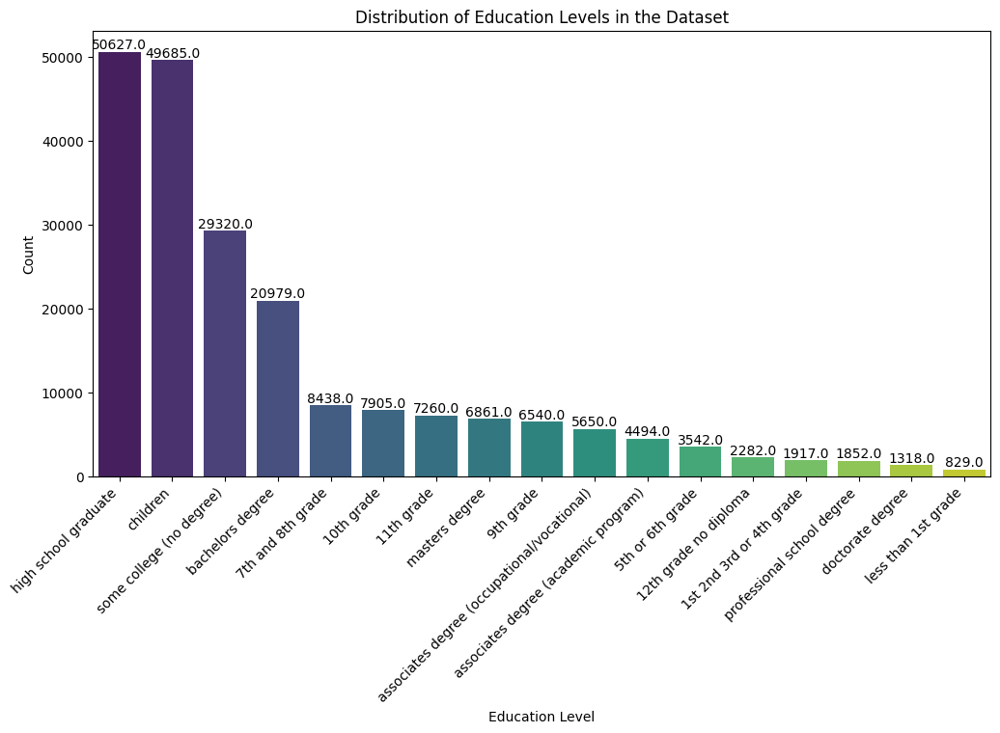

The most common education level among individuals is: high school graduate


In [40]:
# Plot the distribution of education levels with counts on the figure
plt.figure(figsize=(12, 6))
education_plot = sns.countplot(data=new_train, x='education', palette='viridis', order=new_train['education'].value_counts().index)

# Display counts on top of the bars
for p in education_plot.patches:
    education_plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                            ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                            textcoords='offset points')

plt.title('Distribution of Education Levels in the Dataset')
plt.xlabel('Education Level')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.show()


# Identify the most common education level
most_common_education = new_train['education'].mode().values[0]

# Print the most common education level
print(f"The most common education level among individuals is: {most_common_education}")


The presented graph illustrates the distribution and count of participants' education levels. Notably, High school graduates constitute the largest group, totaling 50,627.0, closely followed by Children at 49,685.0. Following these two, the education levels of Some college with no degree, Bachelors degree, and 7th and 8th grade exhibit counts of 29,320.0, 20,979.0, and 8,438.0, respectively. Conversely, the education level with the lowest count, standing at 829.0, is attributed to individuals with Less than 1st grade education.

### Bivariate Question:

* How does education correlate with employment commitment?


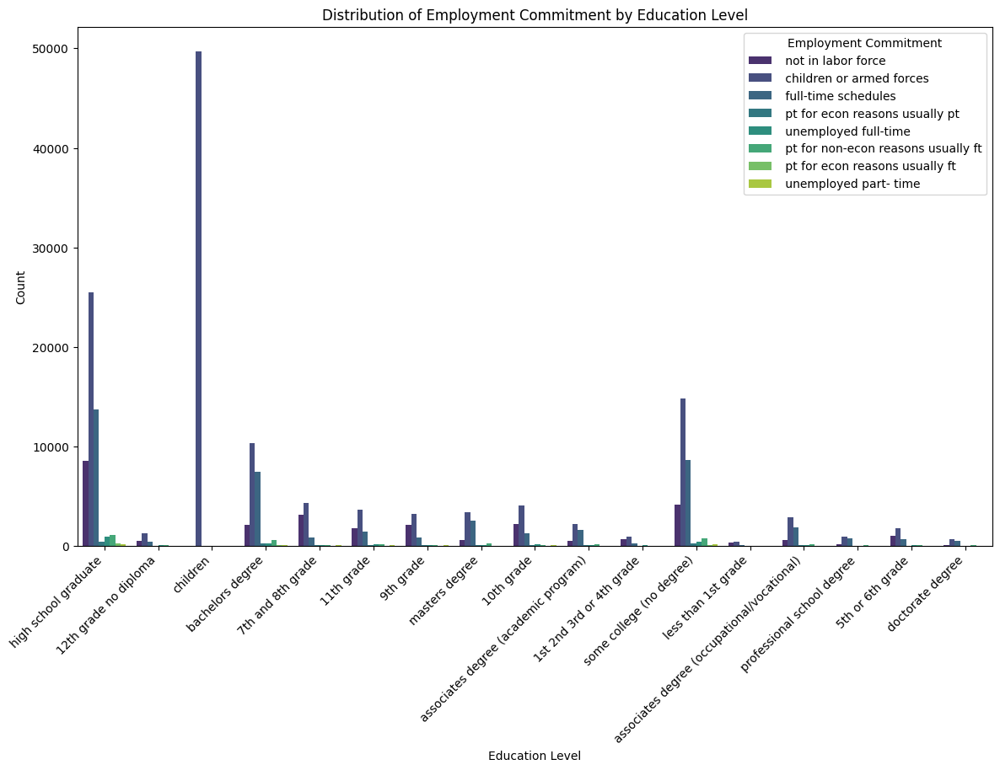

In [41]:
# Create a stacked bar plot
plt.figure(figsize=(14, 8))
sns.countplot(data=new_train, x='education', hue='employment_commitment', palette='viridis')
plt.title('Distribution of Employment Commitment by Education Level')
plt.xlabel('Education Level')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.legend(title='Employment Commitment', loc='upper right')
plt.show()


#### Above graph in plotly 

In [42]:
# Create a grouped DataFrame for counting values
grouped_df = new_train.groupby(['education', 'employment_commitment']).size().reset_index(name='count')

# Create an interactive stacked bar plot using Plotly Express
fig = px.bar(grouped_df, x='education', y='count', color='employment_commitment',
             title='Distribution of Employment Commitment by Education Level',
             labels={'count': 'Count', 'education': 'Education Level'},
             category_orders={'education': new_train['education'].value_counts().index},
             width=800, height=500)

# Rotate x-axis labels for better readability
fig.update_layout(xaxis=dict(tickangle=45, tickmode='array'))

# Show the plot
fig.show()


The graphs above demonstrate the impact of education level of participants to their employment commitment. Overall, Children and armed forces are seen in all education levels with the highest numbers in Children education level, High school graduates,Some college but no degree and those with Bachelors degree. However, all employment commitment is seen among people with High School graduate level of education which forms the highest group in the dataset.  

In [43]:
# Create a contingency table
contingency_table = pd.crosstab(new_train['education'], new_train['employment_commitment'])

# Perform chi-square test
chi2, p, _, _ = chi2_contingency(contingency_table)

# Print the results
print(f"Chi-square value: {chi2}")
print(f"P-value: {p}")

# Interpret the results
if p < 0.05:
    print("There is a significant association between education and employment commitment.")
else:
    print("There is no significant association between education and employment commitment.")


Chi-square value: 53128.74065005501
P-value: 0.0
There is a significant association between education and employment commitment.


From here, we see that a person's educational level determines their employment commitment based on the p-value.

### Multivariate Questions:

* How does the combination of education, age, and race relate to income levels?


<Figure size 1600x800 with 0 Axes>

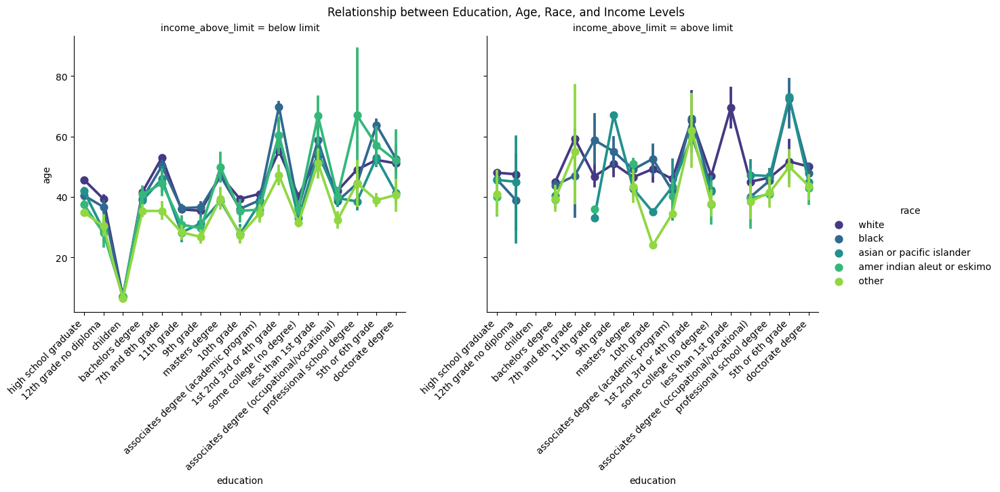

In [44]:
# Create a categorical plot (catplot) with education, age, race, and income levels
plt.figure(figsize=(16, 8))
catplot = sns.catplot(x='education', y='age', hue='race', col='income_above_limit', data=new_train, kind='point', height=5, aspect=1.2, palette='viridis')

# Rotate x-axis labels for better readability
for ax in catplot.axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

plt.suptitle('Relationship between Education, Age, Race, and Income Levels', y=1.02)
plt.show()


In [45]:
# Create a faceted scatter plot with angled x-axis labels
fig = px.scatter(new_train, x='education', y='age', color='income_above_limit', facet_col='race',
                 category_orders={'race': new_train['race'].value_counts().index,
                                  'education': new_train['education'].value_counts().index},
                 labels={'education': 'Education Level', 'age': 'Age', 'race': 'Race'},
                 title='Scatter Plot of Education, Age, Race, and Income Levels',
                 facet_col_wrap=3, height=600, width=1000)

# Rotate x-axis labels for better readability
fig.update_xaxes(tickangle=45)

# Show the plot
fig.show()


In [46]:
# Create a contingency table
contingency_table_gender_marital_class = pd.crosstab(new_train['education'],
                                                     [new_train['age'],
                                                      new_train['race'],
                                                      new_train['income_above_limit']])

# Perform chi-square test
chi2, p, _, _ = chi2_contingency(contingency_table_gender_marital_class)

# Print the results
print(f"Chi-square value: {chi2}")
print(f"P-value: {p}")

# Interpret the results
if p < 0.05:
    print("There is a significant association between education, age,race, and income levels.")
else:
    print("There is no significant association between education,age, race, and income levels.")


Chi-square value: 388781.56105935434
P-value: 0.0
There is a significant association between education, age,race, and income levels.


Based on the p-value analysis, a significant relationship exists between an individual's income levels and their education, age, and race. Specifically, individuals of the white race exhibit income levels—both below and above certain limits—across various age groups and education levels. Notably, children consistently show income levels below limits, irrespective of their race.

In the black race, a similar pattern is observed, with an interesting distinction. Participants with Prof School degree, Doctorate degree, and those above the age of 30 tend to have income levels above the limit. This suggests that fewer participants with these education levels were paid below the limit. Conversely, individuals with less than 1st grade education in the black race had no one earning above the limit.

For individuals of Asian and Pacific Islander, Other race, and Amer Indian Aluet or Eskimo, those with 7th and 8th grade, 9th grade, 10th grade, 11th grade, Masters, Associate degrees (vocational and academic), 5th and 6th grades, and subsequent education levels tend to have more instances of income levels below the limit. Additionally, some education levels within these racial categories have no recorded instances of individuals being paid above the limit.

* How does the combination of gender, marital status, and class relate to income levels?

In [47]:
# Create a faceted scatter plot with angled x-axis labels for gender, marital status, class, and income levels
fig = px.scatter(new_train, x='gender', y='marital_status', color='income_above_limit', facet_col='work_class',
                 category_orders={'gender': new_train['gender'].value_counts().index,
                                  'marital_status': new_train['marital_status'].value_counts().index,
                                  'work_class': new_train['work_class'].value_counts().index},
                 labels={'gender': 'Gender', 'marital_status': 'Marital Status', 'work_class': 'Work Class'},
                 title='Scatter Plot of Gender, Marital Status,Work Class, and Income Levels',
                 facet_col_wrap=3, height=600, width=1000)

# Rotate x-axis labels for better readability
fig.update_xaxes(tickangle=45)

# Show the plot
fig.show()


In [48]:
# Create a contingency table
contingency_table_gender_marital_class = pd.crosstab(new_train['gender'],
                                                     [new_train['marital_status'],
                                                      new_train['work_class'],
                                                      new_train['income_above_limit']])

# Perform chi-square test
chi2, p, _, _ = chi2_contingency(contingency_table_gender_marital_class)

# Print the results
print(f"Chi-square value: {chi2}")
print(f"P-value: {p}")

# Interpret the results
if p < 0.05:
    print("There is a significant association between gender, marital status, work_class, and income levels.")
else:
    print("There is no significant association between gender, marital status, work_class, and income levels.")


Chi-square value: 13317.129335536214
P-value: 0.0
There is a significant association between gender, marital status, work_class, and income levels.


The analysis based on the p-value indicates a meaningful connection between income levels and an individual's gender, marital status, and class of work. Across various classes of work and different marital statuses for both male and female participants, there is an almost equal distribution of individuals being paid above and below the limit within each gender group.

However, there are noteworthy distinctions. Among those who have never worked before, some females who have never married and those with a spouse present recorded income levels above the limit, a trend not observed among male participants. Additionally, in the work class without pay, no female participants were recorded as being paid above the limit. In contrast, some men who have never married had income levels above the limit in this particular work class. 

## Income Distribution Amoung Various groups for more clearer Visualization 

##### Age 

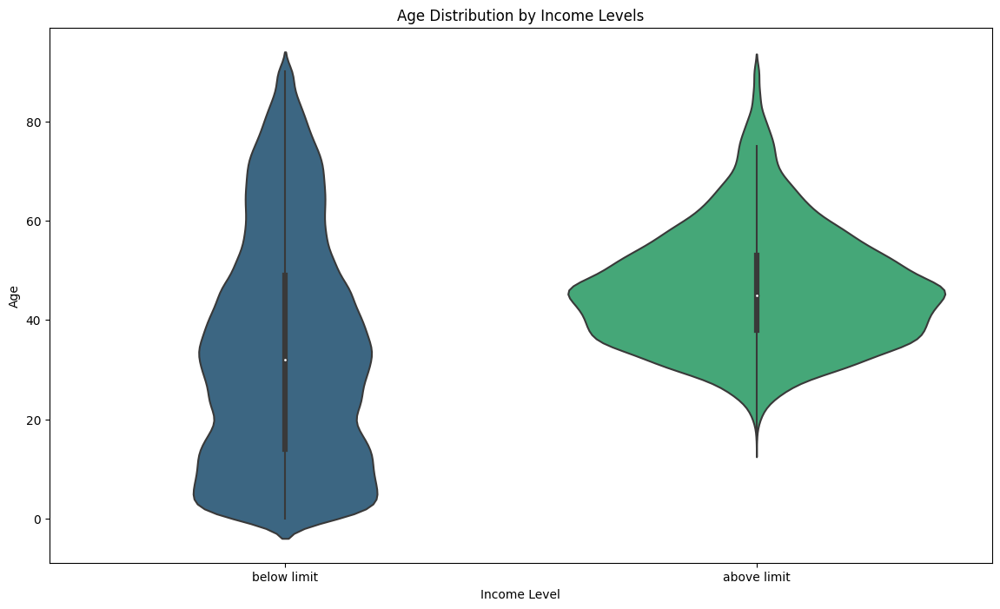

,count,mean,std,min,25%,50%,75%,max
income_above_limit,,,,,,,,
above limit,12998.0,46.323204,11.759821,16.0,38.0,45.0,53.0,90.0
below limit,196501.0,33.737894,22.617047,0.0,14.0,32.0,49.0,90.0


In [49]:
# Violin plot for Age and Income Levels
plt.figure(figsize=(14, 8))
sns.violinplot(x='income_above_limit', y='age', data=new_train, palette='viridis')
plt.title('Age Distribution by Income Levels')
plt.xlabel('Income Level')
plt.ylabel('Age')
plt.show()

# Descriptive statistics for Age by Income Levels
age_stats = new_train.groupby('income_above_limit')['age'].describe()
age_stats

##### Age Distribution Summary:
This report looks at the ages of people in two groups: those "Above limit" and those "Below limit."

1. Number of People:

* In the "Above limit" group, there are about 13,000 people.

* In the "Below limit" group, there are about 196,500 people.

2. Average Age:

* The average age for people "Above limit" is around 46 years.

* The average age for people "Below limit" is around 34 years.

3. Age Range:

The youngest and oldest people in both groups are between 0 and 90 years old.

4. Age Spread:

* Ages in the "Above limit" group are not too spread out, with most people in their 40s.

* Ages in the "Below limit" group vary more, with people of different ages.

5. Age Percentiles:

* In the "Above limit" group, 25% of people are younger than 38, 50% younger than 45, and 75% younger than 53.

* Similar percentages for the "Below limit" group show age distribution.

##### Conclusion:
This report helps us understand how ages are distributed in both groups. On average, people in the "Above limit" group are older, and their ages are more clustered around the average. In the "Below limit" group, ages vary more. These insights can help us learn more about the ages of people in these different categories.

##### Other Groups 

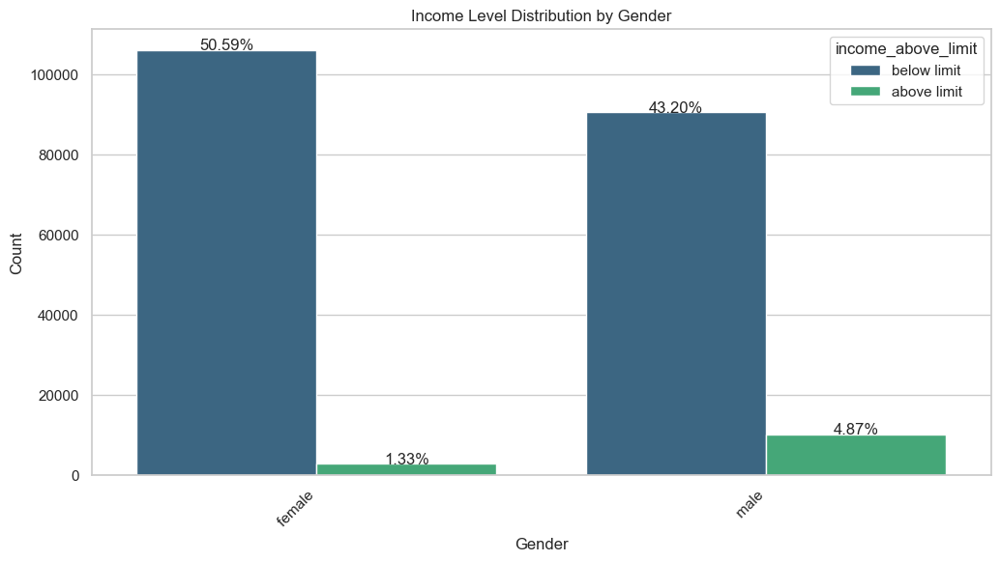

Count Table:
| gender   |   above limit |   below limit |   Total |
|:---------|--------------:|--------------:|--------:|
| female   |          2788 |        105996 |  108784 |
| male     |         10210 |         90505 |  100715 |
| Total    |         12998 |        196501 |  209499 |

Percentage Table:
| gender   |   above limit |   below limit |    Total |
|:---------|--------------:|--------------:|---------:|
| female   |       21.4495 |       53.9417 |  51.9258 |
| male     |       78.5505 |       46.0583 |  48.0742 |
| Total    |      100      |      100      | 100      |


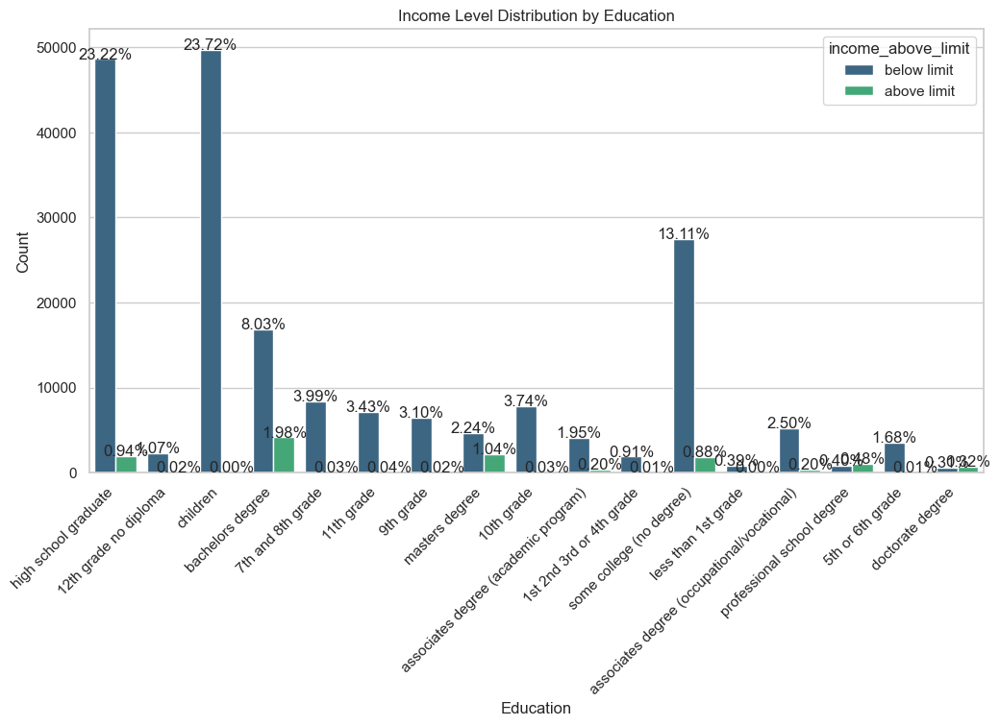

Count Table:
| education                                   |   above limit |   below limit |   Total |
|:--------------------------------------------|--------------:|--------------:|--------:|
| 1st 2nd 3rd or 4th grade                    |            15 |          1902 |    1917 |
| 10th grade                                  |            64 |          7841 |    7905 |
| 11th grade                                  |            82 |          7178 |    7260 |
| 12th grade no diploma                       |            35 |          2247 |    2282 |
| 5th or 6th grade                            |            30 |          3512 |    3542 |
| 7th and 8th grade                           |            72 |          8366 |    8438 |
| 9th grade                                   |            44 |          6496 |    6540 |
| associates degree (academic program)        |           413 |          4081 |    4494 |
| associates degree (occupational/vocational) |           409 |          5241 |    5650

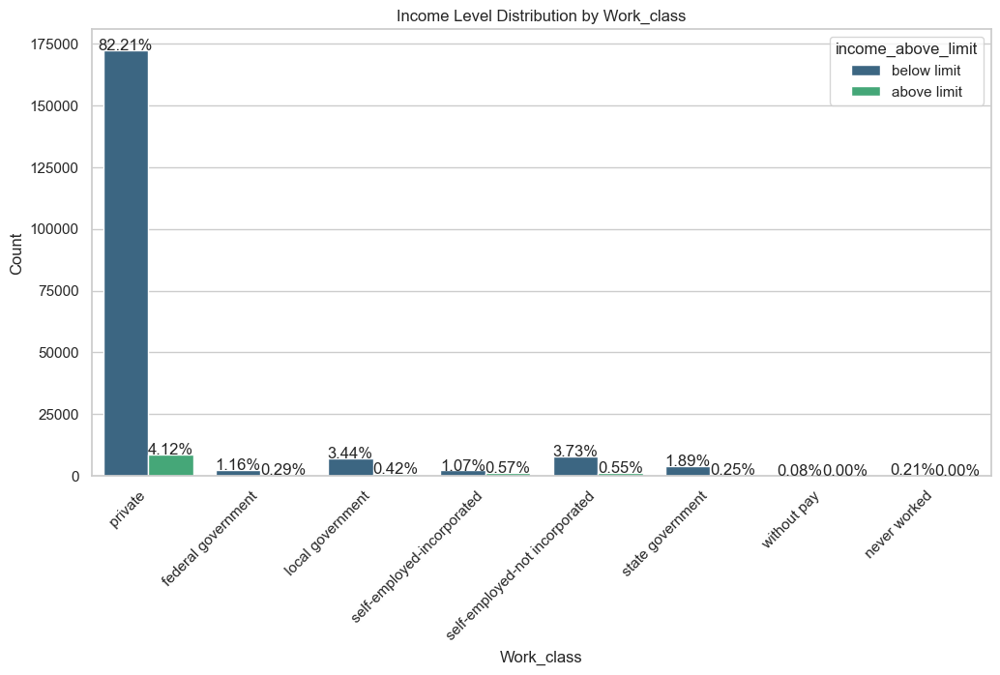

Count Table:
| work_class                     |   above limit |   below limit |   Total |
|:-------------------------------|--------------:|--------------:|--------:|
| federal government             |           612 |          2435 |    3047 |
| local government               |           886 |          7207 |    8093 |
| never worked                   |             2 |           447 |     449 |
| private                        |          8626 |        172236 |  180862 |
| self-employed-incorporated     |          1197 |          2247 |    3444 |
| self-employed-not incorporated |          1145 |          7812 |    8957 |
| state government               |           529 |          3951 |    4480 |
| without pay                    |             1 |           166 |     167 |
| Total                          |         12998 |        196501 |  209499 |

Percentage Table:
| work_class                     |   above limit |   below limit |      Total |
|:-------------------------------|-------

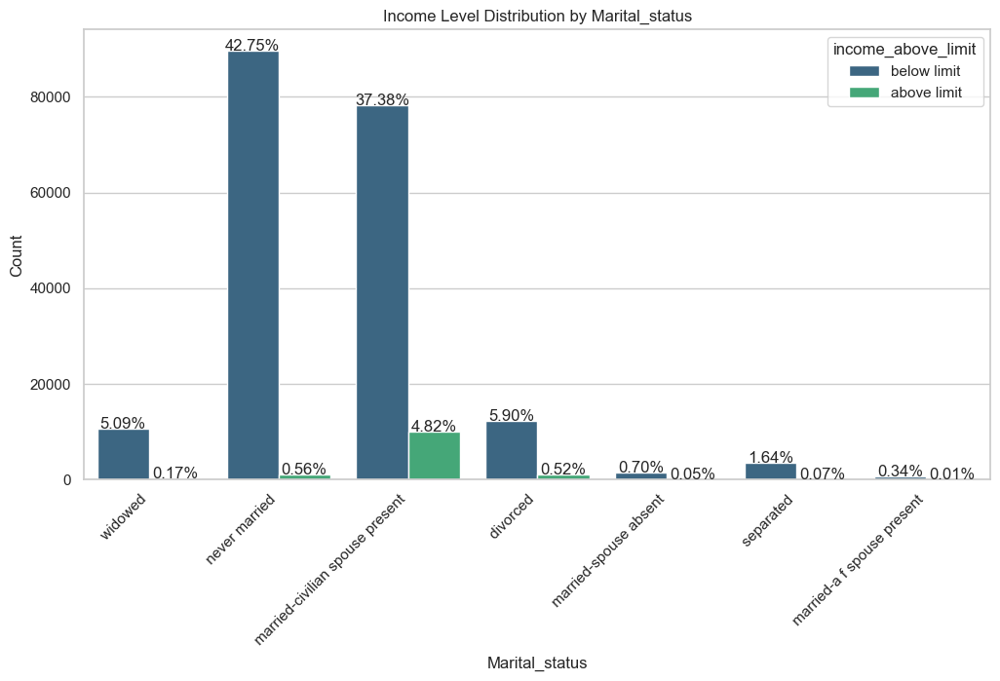

Count Table:
| marital_status                  |   above limit |   below limit |   Total |
|:--------------------------------|--------------:|--------------:|--------:|
| divorced                        |          1095 |         12361 |   13456 |
| married-a f spouse present      |            13 |           707 |     720 |
| married-civilian spouse present |         10094 |         78313 |   88407 |
| married-spouse absent           |           104 |          1464 |    1568 |
| never married                   |          1170 |         89553 |   90723 |
| separated                       |           157 |          3439 |    3596 |
| widowed                         |           365 |         10664 |   11029 |
| Total                           |         12998 |        196501 |  209499 |

Percentage Table:
| marital_status                  |   above limit |   below limit |      Total |
|:--------------------------------|--------------:|--------------:|-----------:|
| divorced                

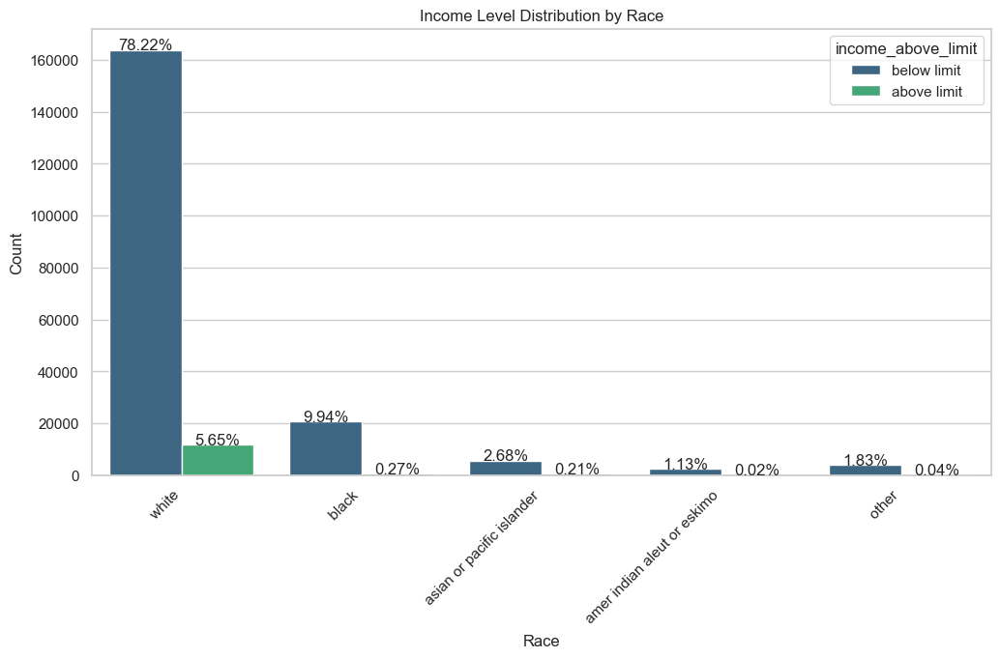

Count Table:
| race                        |   above limit |   below limit |   Total |
|:----------------------------|--------------:|--------------:|--------:|
| amer indian aleut or eskimo |            52 |          2361 |    2413 |
| asian or pacific islander   |           442 |          5614 |    6056 |
| black                       |           574 |         20820 |   21394 |
| other                       |            92 |          3835 |    3927 |
| white                       |         11838 |        163871 |  175709 |
| Total                       |         12998 |        196501 |  209499 |

Percentage Table:
| race                        |   above limit |   below limit |     Total |
|:----------------------------|--------------:|--------------:|----------:|
| amer indian aleut or eskimo |      0.400062 |       1.20152 |   1.1518  |
| asian or pacific islander   |      3.40052  |       2.85698 |   2.89071 |
| black                       |      4.41606  |      10.5954  |  10.212 

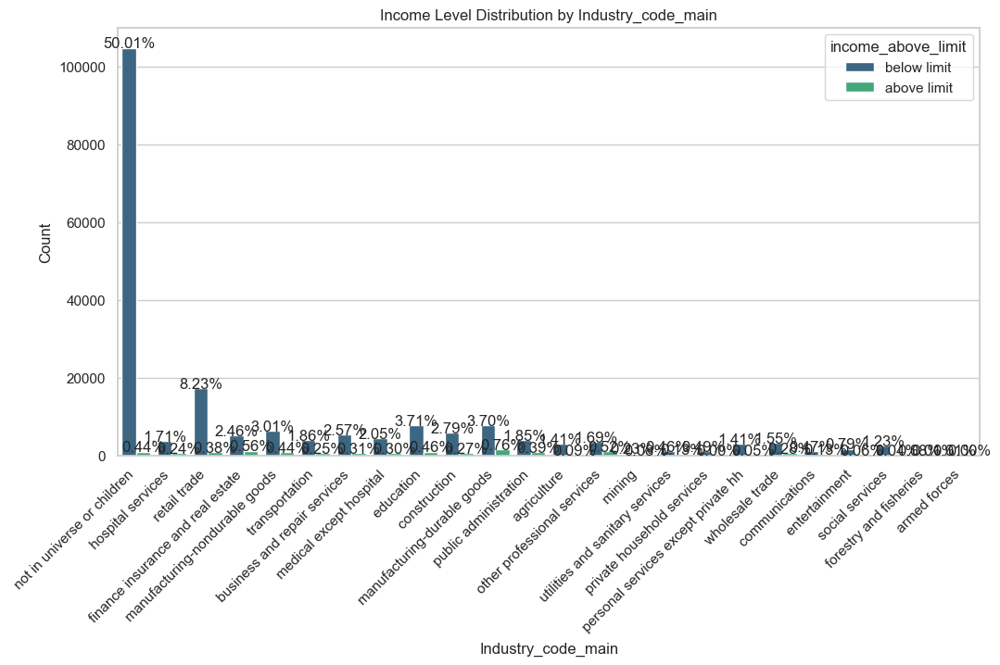

Count Table:
| industry_code_main                  |   above limit |   below limit |   Total |
|:------------------------------------|--------------:|--------------:|--------:|
| agriculture                         |           197 |          2960 |    3157 |
| armed forces                        |             8 |            24 |      32 |
| business and repair services        |           640 |          5381 |    6021 |
| communications                      |           276 |           984 |    1260 |
| construction                        |           567 |          5847 |    6414 |
| education                           |           958 |          7781 |    8739 |
| entertainment                       |           121 |          1658 |    1779 |
| finance insurance and real estate   |          1175 |          5161 |    6336 |
| forestry and fisheries              |            26 |           175 |     201 |
| hospital services                   |           505 |          3583 |    4088 |
| m

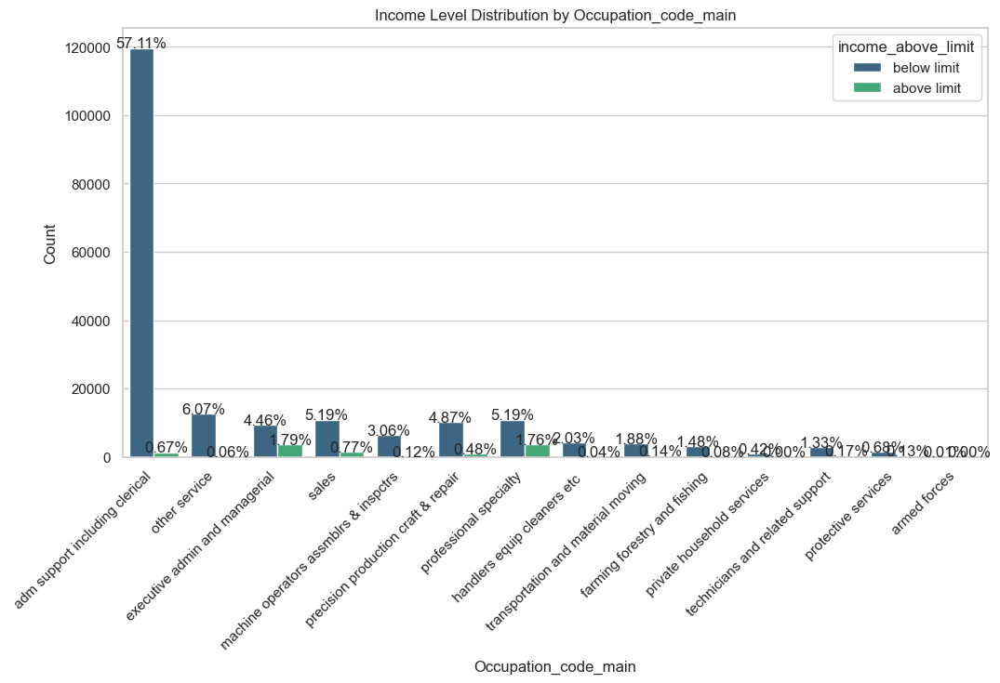

Count Table:
| occupation_code_main                  |   above limit |   below limit |   Total |
|:--------------------------------------|--------------:|--------------:|--------:|
| adm support including clerical        |          1399 |        119646 |  121045 |
| armed forces                          |             8 |            24 |      32 |
| executive admin and managerial        |          3753 |          9354 |   13107 |
| farming forestry and fishing          |           169 |          3104 |    3273 |
| handlers equip cleaners etc           |            77 |          4263 |    4340 |
| machine operators assmblrs & inspctrs |           244 |          6406 |    6650 |
| other service                         |           132 |         12724 |   12856 |
| precision production craft & repair   |          1008 |         10199 |   11207 |
| private household services            |             2 |           876 |     878 |
| professional specialty                |          3677 |      

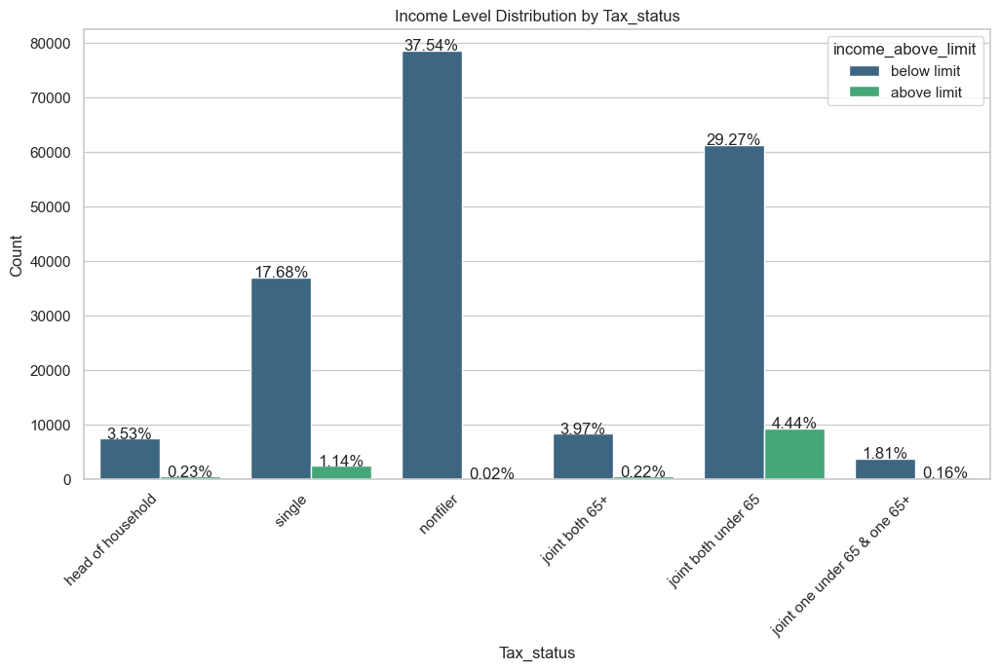

Count Table:
| tax_status                   |   above limit |   below limit |   Total |
|:-----------------------------|--------------:|--------------:|--------:|
| head of household            |           482 |          7400 |    7882 |
| joint both 65+               |           464 |          8327 |    8791 |
| joint both under 65          |          9305 |         61312 |   70617 |
| joint one under 65 & one 65+ |           327 |          3782 |    4109 |
| nonfiler                     |            33 |         78638 |   78671 |
| single                       |          2387 |         37042 |   39429 |
| Total                        |         12998 |        196501 |  209499 |

Percentage Table:
| tax_status                   |   above limit |   below limit |     Total |
|:-----------------------------|--------------:|--------------:|----------:|
| head of household            |      3.70826  |       3.76588 |   3.76231 |
| joint both 65+               |      3.56978  |       4.23764

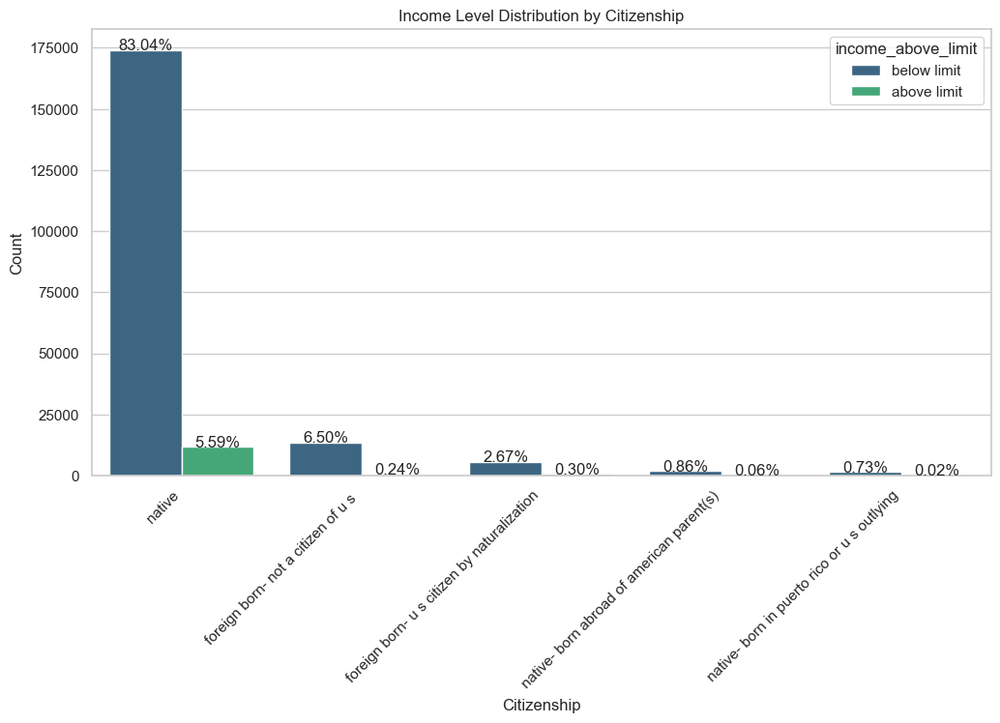

Count Table:
| citizenship                                 |   above limit |   below limit |   Total |
|:--------------------------------------------|--------------:|--------------:|--------:|
| foreign born- not a citizen of u s          |           511 |         13616 |   14127 |
| foreign born- u s citizen by naturalization |           619 |          5589 |    6208 |
| native- born abroad of american parent(s)   |           122 |          1802 |    1924 |
| native- born in puerto rico or u s outlying |            36 |          1535 |    1571 |
| native                                      |         11710 |        173959 |  185669 |
| Total                                       |         12998 |        196501 |  209499 |

Percentage Table:
| citizenship                                 |   above limit |   below limit |      Total |
|:--------------------------------------------|--------------:|--------------:|-----------:|
| foreign born- not a citizen of u s          |      3.93137  

In [50]:
def plot_category_distribution(variable):
    # Set the overall style of the visualization
    sns.set(style="whitegrid")

    # Create the countplot based on the variable
    plt.figure(figsize=(12, 6))
    ax = sns.countplot(x=variable, hue='income_above_limit', data=new_train, palette='viridis')

    # Set plot title and labels
    plt.title(f'Income Level Distribution by {variable.capitalize()}')
    plt.xlabel(variable.capitalize())
    plt.ylabel('Count')

    # Rotate x-axis labels
    plt.xticks(rotation=45, ha="right")

    # Add percentage labels on top of each bar
    total = float(len(new_train))  # Total number of records
    for p in ax.patches:
        height = p.get_height()
        ax.text(p.get_x() + p.get_width()/2., height + 3, f'{height/total:.2%}', ha="center")

    # Show the plot
    plt.show()

    # Display count and percentage in a table
    count_table = pd.crosstab(new_train[variable], new_train['income_above_limit'], margins=True, margins_name='Total')
    percentage_table = (count_table / count_table.loc['Total']) * 100
    print("Count Table:")
    print(count_table.to_markdown())
    print("\nPercentage Table:")
    print(percentage_table.to_markdown())

# List of categorical variables excluding 'age'
categorical_variables_without_age = ['gender', 'education', 'work_class', 'marital_status', 'race',
                                      'industry_code_main', 'occupation_code_main', 'tax_status', 'citizenship']

# Plot the distribution for each categorical variable
for variable in categorical_variables_without_age:
    plot_category_distribution(variable)


The graphs and tables presented above depict the number and percentage distribution of participants receiving payment either below or above the income limit within various groups, including gender, education, work class, marital status, race, industry code, occupation code, tax status, and citizenship.

## Hypothesis 

The chi-square test was used to assess the association between categorical variables, such as age, gender, education, class, marital status, race, industry code, occupation code, tax status, and citizenship, and income levels.

Hypotheses:

* Null hypothesis (H0): there is no association between the examined demographic variables and income levels.

* Alternate hypothesis (H1): there is a significant association between these demographic variables and income distribution.


In [51]:
def test_categorical_association(df, variable):
    # Create a contingency table
    contingency_table = pd.crosstab(df[variable], df['income_above_limit'])

    # Perform chi-square test
    chi2, p, _, _ = chi2_contingency(contingency_table)

    # Output the test results
    print(f"Chi-square statistic for {variable}: {chi2}")
    print(f"P-value for {variable}: {p}")

    # Check for significance at a chosen alpha level (e.g., 0.05)
    alpha = 0.05
    if p < alpha:
        print(f"Reject the null hypothesis for {variable}. There is a significant association.")
    else:
        print(f"Fail to reject the null hypothesis for {variable}. There is no significant association.")
    print("\n")

# List of categorical variables excluding 'age'
categorical_variables= ['age','gender', 'education', 'work_class', 'marital_status', 'race',
                                      'industry_code_main', 'occupation_code_main', 'tax_status', 'citizenship']

# Test the association for each categorical variable
for variable in categorical_variables:
    test_categorical_association(hyp_train, variable)


Chi-square statistic for age: 13253.013924918145
P-value for age: 0.0
Reject the null hypothesis for age. There is a significant association.


Chi-square statistic for gender: 5154.827952374376
P-value for gender: 0.0
Reject the null hypothesis for gender. There is a significant association.


Chi-square statistic for education: 32023.58134968222
P-value for education: 0.0
Reject the null hypothesis for education. There is a significant association.


Chi-square statistic for work_class: 7728.757359683476
P-value for work_class: 0.0
Reject the null hypothesis for work_class. There is a significant association.


Chi-square statistic for marital_status: 8185.082343148208
P-value for marital_status: 0.0
Reject the null hypothesis for marital_status. There is a significant association.


Chi-square statistic for race: 722.6940681167777
P-value for race: 4.2471907565219915e-155
Reject the null hypothesis for race. There is a significant association.


Chi-square statistic for industry_cod

In [52]:
def test_categorical_association(data, variable):
    # Create a contingency table
    contingency_table = pd.crosstab(data[variable], data['income_above_limit'])

    # Perform the chi-square test
    chi2, p, _, _ = chi2_contingency(contingency_table)

    # Create a DataFrame to store the results
    result_df = pd.DataFrame({
        'Variable': [variable],
        'Chi-Square Statistic': [chi2],
        'P-Value': [p],
    })

    return result_df

# Initialize an empty list to store results
association_results = []

# Test the association for each categorical variable
for variable in categorical_variables:
    result_df = test_categorical_association(hyp_train, variable)
    association_results.append(result_df)

# Concatenate the list of DataFrames into a single DataFrame
association_results = pd.concat(association_results, ignore_index=True)

# Display the results DataFrame
association_results


,Variable,Chi-Square Statistic,P-Value
0,age,13253.013925,0.000000e+00
1,gender,5154.827952,0.000000e+00
2,education,32023.581350,0.000000e+00
3,work_class,7728.757360,0.000000e+00
4,marital_status,8185.082343,0.000000e+00
5,race,722.694068,4.247191e-155
6,industry_code_main,16415.136789,0.000000e+00
7,occupation_code_main,28128.615242,0.000000e+00
8,tax_status,11069.285324,0.000000e+00
9,citizenship,358.588487,2.451779e-76


The results of the hypothesis tests suggest that there is a significant association between the examined demographic variables (age, gender, education, class, marital status, race, industry code, occupation code, tax status, and citizenship) and income levels. The rejection of the null hypothesis in each case implies that these demographic factors play a role in determining whether an individual's income is above or below a certain limit.These findings support the project's goal of using machine learning to predict income levels based on demographic factors. The identified associations can contribute valuable insights for policymakers aiming to address income inequality, as they highlight the key demographic variables that influence income distribution.

## Balancing Datasets and Modeling

In [53]:
# checking information
new_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209499 entries, 0 to 209498
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   age                    209499 non-null  int64 
 1   gender                 209499 non-null  object
 2   education              209499 non-null  object
 3   work_class             209499 non-null  object
 4   marital_status         209499 non-null  object
 5   race                   209499 non-null  object
 6   is_hispanic            209499 non-null  object
 7   employment_commitment  209499 non-null  object
 8   wage_per_hour          209499 non-null  int64 
 9   working_week_per_year  209499 non-null  int64 
 10  industry_code_main     209499 non-null  object
 11  occupation_code_main   209499 non-null  object
 12  tax_status             209499 non-null  object
 13  citizenship            209499 non-null  object
 14  income_above_limit     209499 non-null  object
dtype

In [54]:
# Checking the head of the dataset
new_train.head()

,age,gender,education,work_class,marital_status,race,is_hispanic,employment_commitment,wage_per_hour,working_week_per_year,industry_code_main,occupation_code_main,tax_status,citizenship,income_above_limit
0,79,female,high school graduate,private,widowed,white,all other,not in labor force,0,52,not in universe or children,adm support including clerical,head of household,native,below limit
1,65,female,high school graduate,private,widowed,white,all other,children or armed forces,0,0,not in universe or children,adm support including clerical,single,native,below limit
2,21,male,12th grade no diploma,federal government,never married,black,all other,children or armed forces,500,15,hospital services,adm support including clerical,single,native,below limit
3,2,female,children,private,never married,asian or pacific islander,all other,children or armed forces,0,0,not in universe or children,adm support including clerical,nonfiler,native,below limit
4,70,male,high school graduate,private,married-civilian spouse present,white,all other,not in labor force,0,0,not in universe or children,adm support including clerical,joint both 65+,native,below limit


### Balancing the dataset
This is to adress the class imbalance in the dataset

separate the target variable(y) and the other columns (X) 

In [55]:
# separate the target variable and create a dataframe 
target_df = new_train['income_above_limit']
target_df = pd.DataFrame(target_df)

In [56]:
target_df.shape

(209499, 1)

#### Random Oversampling:

Random oversampling involves randomly duplicating instances from the minority class to balance the class distribution.This makes it straightforward to apply to datasets with categorical features and helps prevent the model from being biased toward the majority class, allowing it to learn patterns from the minority class more effectively.

##### SMOTE:

SMOTE, on the other hand, involves creating synthetic instances based on feature interpolation that may not directly correspond to observed instances, potentially making the interpretation of the model more complex. Also the implemention of SMOTE for datasets with categorical features may involve additional steps, such as selecting an appropriate variant of SMOTE that supports categorical features or converting categorical features to a numerical format. 


To prevent the introduction of synthetic instances, Random oversampling was used for balancing the target variables

In [57]:
# Balance the training set using Random Oversampling
oversampler = RandomOverSampler(random_state=42)
balanced_df, target_df_balanced = oversampler.fit_resample(new_train, target_df)

# Check the class distribution after balancing
balanced_class_counts = target_df_balanced.value_counts()
print("\nClass distribution in the training set:")
print(balanced_class_counts)



Class distribution in the training set:
income_above_limit
above limit           196501
below limit           196501
Name: count, dtype: int64


In [58]:
# viewing the information of the balanced train dataset
balanced_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 393002 entries, 0 to 393001
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   age                    393002 non-null  int64 
 1   gender                 393002 non-null  object
 2   education              393002 non-null  object
 3   work_class             393002 non-null  object
 4   marital_status         393002 non-null  object
 5   race                   393002 non-null  object
 6   is_hispanic            393002 non-null  object
 7   employment_commitment  393002 non-null  object
 8   wage_per_hour          393002 non-null  int64 
 9   working_week_per_year  393002 non-null  int64 
 10  industry_code_main     393002 non-null  object
 11  occupation_code_main   393002 non-null  object
 12  tax_status             393002 non-null  object
 13  citizenship            393002 non-null  object
 14  income_above_limit     393002 non-null  object
dtype

In [59]:
# Drop it from the train dataset
balanced_df = balanced_df.drop('income_above_limit', axis=1)

In [60]:
balanced_df.shape

(393002, 14)

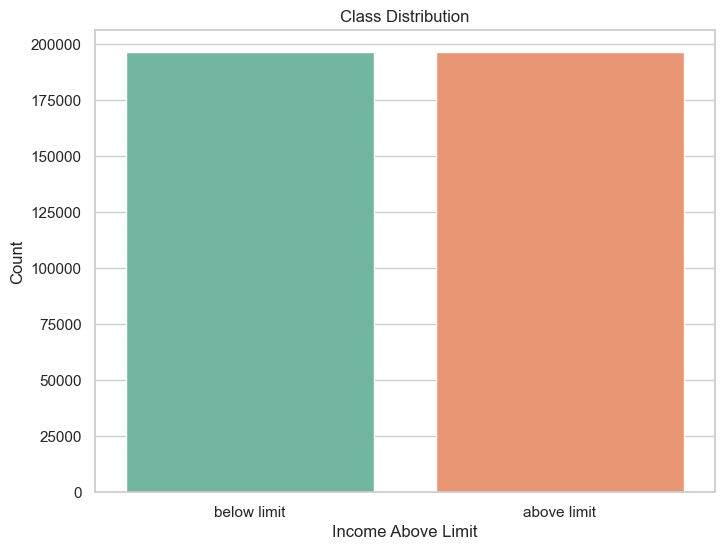

In [61]:
# Count the occurrences of each class in the balanced dataset
class_counts = target_df_balanced ['income_above_limit'].value_counts()

# Create a bar plot with the 'viridis' color palette
plt.figure(figsize=(8, 6))
sns.barplot(x=class_counts.index, y=class_counts.values, palette='Set2')
plt.xlabel('Income Above Limit')
plt.ylabel('Count')
plt.title('Class Distribution')
plt.show()

####  Data Splitting 

In [63]:
# Define your feature matrix 'X' and target variable 'y'
X = balanced_df
y = target_df_balanced['income_above_limit']

# Split the data into a training set and an evaluation set (i.e., 80% training, 20% evaluation)
X_train, X_eval, y_train, y_eval = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [64]:
print("Shape of the Training Set (X_train, y_train):", X_train.shape, y_train.shape)
print("Shape of the Evaluation Set (X_eval, y_eval):", X_eval.shape, y_eval.shape)

Shape of the Training Set (X_train, y_train): (314401, 14) (314401,)
Shape of the Evaluation Set (X_eval, y_eval): (78601, 14) (78601,)


### Creating Pipeline and Preprocessor for Modeling

In [65]:
# Define numerical and categorical features
numerical_features = X.select_dtypes(include=['int64', 'float64']).columns
categorical_features = X.select_dtypes(include=['object']).columns

In [66]:
print(numerical_features)

Index(['age', 'wage_per_hour', 'working_week_per_year'], dtype='object')


In [67]:
print(categorical_features)

Index(['gender', 'education', 'work_class', 'marital_status', 'race',
       'is_hispanic', 'employment_commitment', 'industry_code_main',
       'occupation_code_main', 'tax_status', 'citizenship'],
      dtype='object')


In [68]:
# Define preprocessing steps for numerical and categorical features
numerical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


In [69]:
# Combine transformers for numerical and categorical features
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_features),
        ('cat', categorical_transformer, categorical_features)
    ])

Label encoding simplifies the training process for models. It converts categorical labels into numerical equivalents, allowing the model to process the information more easily during the training phase.

In [70]:
# encoding the target variable

label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)
y_eval_encoded = label_encoder.transform(y_eval)

## Modeling 

For this project, 4 models were used namely:
1. Catboost Model
2. Decision Tree
3. Logistic Regression 


#### 1. CatBoost Model:
###### Advantages:

* Categorical Feature Handling: CatBoost is designed to handle categorical features efficiently without the need for one-hot encoding. This is beneficial when dealing with datasets where a significant portion of features are categorical.

* Automatic Handling of Missing Values: CatBoost can handle missing values in the dataset without the need for explicit imputation. This can simplify preprocessing steps.
###### Disadvantages:

* Computationally Intensive: Training a CatBoost model can be computationally intensive, especially for large datasets or complex models. It may require more time and computational resources.

#### 2. Decision Tree:
###### Advantages:

* Interpretability: Decision trees are easy to interpret and understand. They provide a clear representation of decision-making based on features.
* No Assumption of Linearity: Decision trees do not assume a linear relationship between features, making them suitable for capturing non-linear patterns in the data.
###### Disadvantages:

* Overfitting: Decision trees are prone to overfitting, especially if the tree depth is not appropriately controlled. Overfitting can lead to poor generalization on new, unseen data.

* Instability: Small changes in the data can lead to different tree structures, making decision trees less stable.

#### 3. Logistic Regression:
###### Advantages:

* Interpretability: Logistic Regression provides coefficients for each feature, allowing for straightforward interpretation of the impact of each feature on the target variable.
* Efficient Training: Logistic Regression is computationally efficient and can handle large datasets with relatively low computational resources.
###### Disadvantages:

* Linear Decision Boundary: Logistic Regression assumes a linear decision boundary. It may not perform well when dealing with complex, non-linear relationships in the data.
* Assumption of Independence: Logistic Regression assumes that features are independent of each other. If features are highly correlated, it might affect model performance.

##### Overall Considerations:
Ensemble Models: Consider using ensemble models (e.g., Random Forest, Gradient Boosting) to leverage the strengths of multiple models and mitigate their individual weaknesses.

* Hyperparameter Tuning: Proper hyperparameter tuning is essential for optimizing the performance of each model.

* Evaluation Metrics: Choose appropriate evaluation metrics based on the project's goals (precision, recall, F1 score, etc.).

#### Modeling with CATBOOST

In [71]:
# We will convert categorical columns to string data type and capture the indices where string datatype is present for the CatBoost model.

# Selecting object data type columns (categorical columns) in the training dataset
cat_cols_index = np.where(X.dtypes == 'object')[0]
print("The indices of the categorical columns are:")
print(cat_cols_index)
print()


for i in range(len(X_train.columns)):
    if i in cat_cols_index:
        X_train[X_train.columns[i]] = X_train[X_train.columns[i]].astype(str)
        X_eval[X_train.columns[i]] = X_eval[X_train.columns[i]].astype(str)
        new_test[X_train.columns[i]] = new_test[X_train.columns[i]].astype(str)

# Initialize the CatBoostClassifier model
model = CatBoostClassifier(random_state=42, n_estimators=50)

# Fit the CatBoost model on the training data with categorical features specified
catboost_model = model.fit(X_train, y_train, cat_features=cat_cols_index)

The indices of the categorical columns are:
[ 1  2  3  4  5  6  7 10 11 12 13]

Learning rate set to 0.5
0:	learn: 0.5228738	total: 594ms	remaining: 29.1s
1:	learn: 0.4390823	total: 1.13s	remaining: 27s
2:	learn: 0.4035248	total: 1.49s	remaining: 23.3s
3:	learn: 0.3682290	total: 1.91s	remaining: 22s
4:	learn: 0.3545838	total: 2.23s	remaining: 20.1s
5:	learn: 0.3459384	total: 2.58s	remaining: 18.9s
6:	learn: 0.3372989	total: 2.91s	remaining: 17.9s
7:	learn: 0.3325794	total: 3.25s	remaining: 17.1s
8:	learn: 0.3296034	total: 3.58s	remaining: 16.3s
9:	learn: 0.3267872	total: 3.92s	remaining: 15.7s
10:	learn: 0.3253409	total: 4.28s	remaining: 15.2s
11:	learn: 0.3241855	total: 4.61s	remaining: 14.6s
12:	learn: 0.3224726	total: 4.95s	remaining: 14.1s
13:	learn: 0.3218227	total: 5.27s	remaining: 13.6s
14:	learn: 0.3205853	total: 5.6s	remaining: 13.1s
15:	learn: 0.3198316	total: 5.93s	remaining: 12.6s
16:	learn: 0.3189853	total: 6.26s	remaining: 12.2s
17:	learn: 0.3183550	total: 6.58s	remaining

#### Prediction on Evaluation data

In [72]:
accuracy = accuracy_score(model.predict(X_eval),y_eval)

print(colored(f'The accuracy attained on the validation set is {accuracy}','green',attrs=['bold']))

The accuracy attained on the validation set is 0.866630195544586


In [73]:
print('The classification report only on the validation data:')
print(colored(classification_report(y_eval, model.predict(X_eval)),'blue',attrs=['bold']))

print('The classification report only on the train data:')
print(colored(classification_report(y_train, model.predict(X_train)),'green',attrs=['bold']))

The classification report only on the validation data:
              precision    recall  f1-score   support

 above limit       0.85      0.89      0.87     39301
 below limit       0.89      0.84      0.86     39300

    accuracy                           0.87     78601
   macro avg       0.87      0.87      0.87     78601
weighted avg       0.87      0.87      0.87     78601

The classification report only on the train data:
              precision    recall  f1-score   support

 above limit       0.85      0.90      0.87    157200
 below limit       0.89      0.84      0.86    157201

    accuracy                           0.87    314401
   macro avg       0.87      0.87      0.87    314401
weighted avg       0.87      0.87      0.87    314401



#### Using other Models for Prediction and Evaluation

In [74]:
#  #Create a pipeline with preprocessing steps

# knnpipeline = ImbPipeline(steps=[
#     ('preprocessor', preprocessor),
#     ('oversample', oversampler),
#     ('kneighbor', KNeighborsClassifier())
    
#     ])

# # Transform the dataset using the pipeline
# knnpipeline.fit(X_train, y_train_encoded)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  Index(['age', 'wage_per_hour', 'working_week_per_year'], dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  Index(['gender', 'education', 'work_class', 'marital_status', 'race',
       'is_hispanic', 'employment_commitment', 'industry_code_main',
       'occupation_code_main', 'tax_status', 'citizenship'],
      dtype='object'))])),
                ('oversample', RandomOverSampler(random_state=42)),
                ('kneighbor', KNeighborsClassifier())])

In [75]:
 #Create a pipeline with preprocessing steps

logpipeline = ImbPipeline(steps=[
    ('preprocessor', preprocessor),
    ('oversample', oversampler),
    ('logisticReg', LogisticRegression())
    
    ])

# Transform the dataset using the pipeline
logpipeline.fit(X_train, y_train_encoded)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  Index(['age', 'wage_per_hour', 'working_week_per_year'], dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  Index(['gender', 'education', 'work_class', 'marital_status', 'race',
       'is_hispanic', 'employment_commitment', 'industry_code_main',
       'occupation_code_main', 'tax_status', 'citizenship'],
      dtype='object'))])),
                ('oversample', RandomOverSampler(random_state=42)),
                ('logisticReg', LogisticRegression())])

In [76]:
 #Create a pipeline with preprocessing steps

decision_pipeline = ImbPipeline(steps=[
    ('preprocessor', preprocessor),
    ('oversample', oversampler),
     ('decision_tree', DecisionTreeClassifier())
    
    ])

# Transform the dataset using the pipeline
decision_pipeline.fit(X_train, y_train_encoded)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  Index(['age', 'wage_per_hour', 'working_week_per_year'], dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  Index(['gender', 'education', 'work_class', 'marital_status', 'race',
       'is_hispanic', 'employment_commitment', 'industry_code_main',
       'occupation_code_main', 'tax_status', 'citizenship'],
      dtype='object'))])),
                ('oversample', RandomOverSampler(random_state=42)),
                ('decision_tree', DecisionTreeClassifier())])

In [77]:
d_tree = decision_pipeline.predict(X_eval)

In [78]:
print(classification_report(y_eval_encoded,d_tree))

              precision    recall  f1-score   support

           0       0.94      1.00      0.97     39301
           1       1.00      0.94      0.97     39300

    accuracy                           0.97     78601
   macro avg       0.97      0.97      0.97     78601
weighted avg       0.97      0.97      0.97     78601



In [81]:
logreg_pred = logpipeline .predict(X_eval)

In [82]:
print(classification_report(y_eval_encoded,logreg_pred))

              precision    recall  f1-score   support

           0       0.84      0.88      0.86     39301
           1       0.87      0.83      0.85     39300

    accuracy                           0.85     78601
   macro avg       0.86      0.85      0.85     78601
weighted avg       0.86      0.85      0.85     78601



### Feature Importance for Catboost

Feature importance in CatBoost refers to the measure of the impact or contribution of each feature in the model's decision-making process. CatBoost provides a natural way to calculate feature importance based on how often a feature is used in decision-making across all trees in the ensemble.

In [85]:
# Get feature importances from the trained CatBoost model
feature_importances = catboost_model.feature_importances_

# Create a DataFrame to display feature importances
feature_importance_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importances})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Display the feature importances
feature_importance_df

,Feature,Importance
9,working_week_per_year,18.073231
0,age,15.087101
2,education,14.086343
11,occupation_code_main,10.965091
1,gender,10.853771
10,industry_code_main,8.415772
12,tax_status,7.202706
3,work_class,5.369630
8,wage_per_hour,3.635481
4,marital_status,2.516073


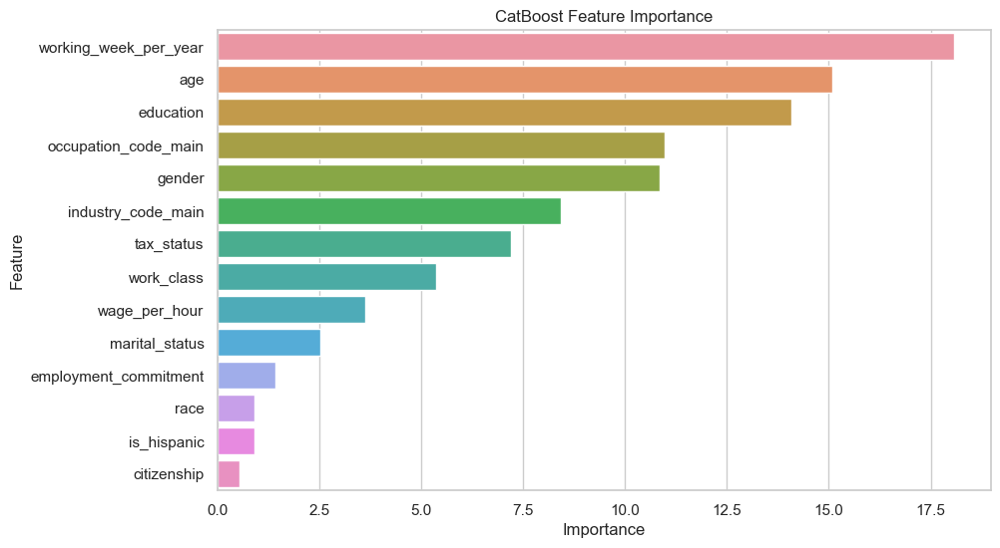

In [86]:
# Assuming 'feature_importance' is the DataFrame obtained from get_feature_importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df.sort_values(by='Importance', ascending=False))
plt.title('CatBoost Feature Importance')
plt.show()


### Saving Catboost Model 

In [88]:
# Extract and store the unique values
unique_values = {}
for column in new_train.columns:
    unique_values[column] = new_train[column].unique()

#Save unique values and model together in a single pickle file
file_path = 'model_and_all_components.pkl'

# Create a dictionary to store the components
all_components = {
    'model': catboost_model,
    'unique_values': unique_values
}

# Save all components in a single pickle file
with open(file_path, 'wb') as file:
    pickle.dump(all_components, file)

In [89]:
# Load saved components from the pickle file
with open(file_path, 'rb') as file:
    loaded_components = pickle.load(file)

# Access the loaded components
loaded_model = loaded_components['model']
loaded_unique_values = loaded_components['unique_values']


### Saving the Decision tree model and encoder

In [90]:
joblib.dump(decision_pipeline, 'dtree_pipeline.joblib')
joblib.dump(label_encoder, 'labelencoderbal.joblib')

['labelencoderbal.joblib']

#### Extracting Model and Data Unique Values:

The code iterates through each column in the new_train DataFrame.
For each column, it retrieves the unique values using the unique() method.
The unique values for each column are stored in a dictionary named unique_values.
Saving Components:

A file path (file_path) is defined where the pickle file will be saved.

A dictionary named all_components is created to store two main components:
* 'model': This component contains the CatBoost model (catboost_model).

* 'unique_values': This component contains the dictionary of unique values for each column.

The pickle.dump function is used to save the entire saved_components dictionary into a single pickle file specified by file_path.

#### Purpose:

This approach allows you to save both the trained CatBoost model and the information about the unique values present in the training data in a single file.
Storing unique values can be useful for consistency, especially when you want to apply the same preprocessing steps to new data before making predictions with the saved model.

#### Usage:

When you later want to use the model for predictions on new data, you can load both the model and the unique values dictionary from the pickle file and apply the same preprocessing steps to the new data.

### For this project,
- **Decision Tree:** <span style="color:green;">Decision Tree</span>
- **CatBoost:** <span style="color:green;">CatBoost</span> models were used for test prediction. <span style="color:green;">Decision Tree</span> gave an accuracy of <span style="color:blue;">0.97</span> while Catboost had <span style="color:blue;">0.86</span>.
Test prediction ability of both models were explored. 




## Test Prediction

using the trained models to predict the target variables of unkown(test) data.

In [91]:
# View the head of the test dataset
new_test.head()

,age,gender,education,work_class,marital_status,race,is_hispanic,employment_commitment,wage_per_hour,working_week_per_year,industry_code_main,occupation_code_main,tax_status,citizenship
0,54,male,high school graduate,private,married-civilian spouse present,white,all other,children or armed forces,600,46,transportation,transportation and material moving,joint both under 65,native
1,53,male,5th or 6th grade,private,married-civilian spouse present,white,central or south american,full-time schedules,0,52,manufacturing-durable goods,machine operators assmblrs & inspctrs,joint both under 65,foreign born- not a citizen of u s
2,42,male,bachelors degree,private,married-civilian spouse present,white,all other,full-time schedules,0,44,business and repair services,professional specialty,joint both under 65,native
3,16,female,9th grade,private,never married,white,all other,children or armed forces,0,8,not in universe or children,adm support including clerical,single,native
4,16,male,9th grade,private,never married,white,all other,not in labor force,0,0,not in universe or children,adm support including clerical,nonfiler,native


In [92]:
new_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 89786 entries, 0 to 89785
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   age                    89786 non-null  int64 
 1   gender                 89786 non-null  object
 2   education              89786 non-null  object
 3   work_class             89786 non-null  object
 4   marital_status         89786 non-null  object
 5   race                   89786 non-null  object
 6   is_hispanic            89786 non-null  object
 7   employment_commitment  89786 non-null  object
 8   wage_per_hour          89786 non-null  int64 
 9   working_week_per_year  89786 non-null  int64 
 10  industry_code_main     89786 non-null  object
 11  occupation_code_main   89786 non-null  object
 12  tax_status             89786 non-null  object
 13  citizenship            89786 non-null  object
dtypes: int64(3), object(11)
memory usage: 9.6+ MB


### 1. Test predict with Catboost model

In [93]:
# Perform Predictions
y_pred = loaded_model.predict(new_test)

# Create a new DataFrame with the 'income_above_limit' predictions
test_predict = new_test.copy()
test_predict['income_above_limit'] = y_pred

# Display Predictions (first few rows)
test_predict.head()

,age,gender,education,work_class,marital_status,race,is_hispanic,employment_commitment,wage_per_hour,working_week_per_year,industry_code_main,occupation_code_main,tax_status,citizenship,income_above_limit
0,54,male,high school graduate,private,married-civilian spouse present,white,all other,children or armed forces,600,46,transportation,transportation and material moving,joint both under 65,native,above limit
1,53,male,5th or 6th grade,private,married-civilian spouse present,white,central or south american,full-time schedules,0,52,manufacturing-durable goods,machine operators assmblrs & inspctrs,joint both under 65,foreign born- not a citizen of u s,below limit
2,42,male,bachelors degree,private,married-civilian spouse present,white,all other,full-time schedules,0,44,business and repair services,professional specialty,joint both under 65,native,above limit
3,16,female,9th grade,private,never married,white,all other,children or armed forces,0,8,not in universe or children,adm support including clerical,single,native,below limit
4,16,male,9th grade,private,never married,white,all other,not in labor force,0,0,not in universe or children,adm support including clerical,nonfiler,native,below limit


In [94]:
# dataframe containing only Id column
original_ids_df

,ID
0,ID_TZ209499
1,ID_TZ209500
2,ID_TZ209501
3,ID_TZ209502
4,ID_TZ209503
...,...
89781,ID_TZ299280
89782,ID_TZ299281
89783,ID_TZ299282
89784,ID_TZ299283


In [95]:
# Concatenate the dataframes along columns
merged_test = pd.concat([original_ids_df, test_predict ], axis=1)

In [96]:
# Display the resulting dataframe
merged_test.head()

,ID,age,gender,education,work_class,marital_status,race,is_hispanic,employment_commitment,wage_per_hour,working_week_per_year,industry_code_main,occupation_code_main,tax_status,citizenship,income_above_limit
0,ID_TZ209499,54,male,high school graduate,private,married-civilian spouse present,white,all other,children or armed forces,600,46,transportation,transportation and material moving,joint both under 65,native,above limit
1,ID_TZ209500,53,male,5th or 6th grade,private,married-civilian spouse present,white,central or south american,full-time schedules,0,52,manufacturing-durable goods,machine operators assmblrs & inspctrs,joint both under 65,foreign born- not a citizen of u s,below limit
2,ID_TZ209501,42,male,bachelors degree,private,married-civilian spouse present,white,all other,full-time schedules,0,44,business and repair services,professional specialty,joint both under 65,native,above limit
3,ID_TZ209502,16,female,9th grade,private,never married,white,all other,children or armed forces,0,8,not in universe or children,adm support including clerical,single,native,below limit
4,ID_TZ209503,16,male,9th grade,private,never married,white,all other,not in labor force,0,0,not in universe or children,adm support including clerical,nonfiler,native,below limit


In [97]:
# copy of predicted test dataframe 
submission_result = merged_test.copy()

# Assuming your dataframe is named merged_test
merged_test['income_above_limit'] = merged_test['income_above_limit'].replace({0: 'Below limit', 1: 'Above limit'})

# Display the updated dataframe
merged_test


,ID,age,gender,education,work_class,marital_status,race,is_hispanic,employment_commitment,wage_per_hour,working_week_per_year,industry_code_main,occupation_code_main,tax_status,citizenship,income_above_limit
0,ID_TZ209499,54,male,high school graduate,private,married-civilian spouse present,white,all other,children or armed forces,600,46,transportation,transportation and material moving,joint both under 65,native,above limit
1,ID_TZ209500,53,male,5th or 6th grade,private,married-civilian spouse present,white,central or south american,full-time schedules,0,52,manufacturing-durable goods,machine operators assmblrs & inspctrs,joint both under 65,foreign born- not a citizen of u s,below limit
2,ID_TZ209501,42,male,bachelors degree,private,married-civilian spouse present,white,all other,full-time schedules,0,44,business and repair services,professional specialty,joint both under 65,native,above limit
3,ID_TZ209502,16,female,9th grade,private,never married,white,all other,children or armed forces,0,8,not in universe or children,adm support including clerical,single,native,below limit
4,ID_TZ209503,16,male,9th grade,private,never married,white,all other,not in labor force,0,0,not in universe or children,adm support including clerical,nonfiler,native,below limit
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89781,ID_TZ299280,5,male,children,private,never married,white,all other,children or armed forces,0,0,not in universe or children,adm support including clerical,nonfiler,native,below limit
89782,ID_TZ299281,81,female,7th and 8th grade,private,married-civilian spouse present,white,all other,not in labor force,0,0,not in universe or children,adm support including clerical,joint both 65+,native,below limit
89783,ID_TZ299282,65,female,high school graduate,federal government,married-civilian spouse present,white,other spanish,children or armed forces,0,52,forestry and fisheries,other service,joint one under 65 & one 65+,native,below limit
89784,ID_TZ299283,38,female,high school graduate,private,married-a f spouse present,white,all other,full-time schedules,0,43,retail trade,sales,joint both under 65,native,below limit


In [98]:
# checking for unique values in each column
submission_result.columns

Index(['ID', 'age', 'gender', 'education', 'work_class', 'marital_status',
       'race', 'is_hispanic', 'employment_commitment', 'wage_per_hour',
       'working_week_per_year', 'industry_code_main', 'occupation_code_main',
       'tax_status', 'citizenship', 'income_above_limit'],
      dtype='object')

In [99]:
# Define the columns to drop
columns_to_drop = [ 'age', 'gender', 'education', 'work_class',
       'marital_status', 'race', 'is_hispanic', 'employment_commitment',
       'wage_per_hour', 'working_week_per_year', 'industry_code_main',
       'occupation_code_main', 'tax_status', 'citizenship']

# Create a new DataFrame with the specified columns dropped
submission_result = submission_result.drop(columns=columns_to_drop).copy()


In [100]:
# submission result obtained with catboost model
submission_result

,ID,income_above_limit
0,ID_TZ209499,above limit
1,ID_TZ209500,below limit
2,ID_TZ209501,above limit
3,ID_TZ209502,below limit
4,ID_TZ209503,below limit
...,...,...
89781,ID_TZ299280,below limit
89782,ID_TZ299281,below limit
89783,ID_TZ299282,below limit
89784,ID_TZ299283,below limit


### 2. Test Predict with Decision Tree Model (chosen model)

In [101]:
# store predicted data into predicted test variable(gives a numpy array)
predicted_test = decision_pipeline.predict(new_test)

In [102]:
# create a dataframe for the predicted variable
pred_test = pd.DataFrame({ 'income_above_limit': predicted_test})

In [103]:
# concatinate the predicted dataframe with the ID dataframe
prediction_df = pd.concat([original_ids_df, pred_test], axis=1)

In [104]:
# Print or display the prediction DataFrame
prediction_df

,ID,income_above_limit
0,ID_TZ209499,1
1,ID_TZ209500,1
2,ID_TZ209501,0
3,ID_TZ209502,1
4,ID_TZ209503,1
...,...,...
89781,ID_TZ299280,1
89782,ID_TZ299281,1
89783,ID_TZ299282,1
89784,ID_TZ299283,1


#### Save both submission datasets 

In [105]:
# Save the results dataframe to a csv file.
prediction_df.to_csv('data/decision_tree_predicted_result.csv', index=False)

In [106]:
# Save the results dataframe to a csv file.
submission_result.to_csv('data/submission_result.csv', index=False)

## Importance of Income Prediction Project for stakeholders
Policy makers can use the predictions from the machine learning model to gain insights into income distribution within the population. With this information, they can formulate targeted policies and interventions to address specific challenges related to income inequality. Here are some ways policy makers might use the model:

**Targeted Economic Programs:** Identify regions or groups of people that are more likely to have lower incomes. Implement economic programs and initiatives in these areas to stimulate job creation, education, and skill development.

**Education and Training:** Focus on educational programs and training opportunities for individuals predicted to have lower incomes. This can help uplift people by enhancing their skills and qualifications for better job opportunities.

**Social Welfare Programs:** Allocate resources efficiently by directing social welfare programs to those who are more likely to fall below the income threshold. This ensures that support reaches those who need it the most.

**Labor Market Regulations:** Use insights from the model to inform labor market regulations. This may involve adjusting minimum wage levels, promoting fair labor practices, or encouraging industries that contribute to higher income levels.

**Infrastructure Development:** Invest in infrastructure projects in areas with predicted lower incomes. This can create job opportunities and improve living conditions, contributing to overall economic development.

**Financial Inclusion:** Promote financial inclusion initiatives to empower individuals with lower predicted incomes, providing them with access to banking and financial services that can support economic growth.

## Conclusion

**1. Age Significance:** Age is a critical factor influencing income levels, indicating that strategies focusing on age-related workforce development and support could positively impact income distribution.

**2. Gender Disparities:** Substantial income disparities exist between genders, emphasizing the need for targeted initiatives to address gender-related challenges and promote equal opportunities in the workforce.

**2. Educational Impact:** Higher levels of education are associated with increased income, suggesting that investing in education and skill development programs can contribute significantly to reducing income inequality.

**2. Work Class Influence:** The type of employment significantly affects income, highlighting the importance of creating diverse job opportunities and improving working conditions across different sectors.

**3. Marital Status Matters:** Marital status plays a significant role in income distribution, indicating that policies supporting various marital statuses could contribute to a more equitable income distribution.

**4. Racial Disparities:** Noteworthy differences in income distribution among different races suggest the importance of implementing strategies to address racial disparities and promote inclusivity in the workforce.

**5. Industry and Occupation Impact:** The industry and occupation in which individuals are employed significantly influence income levels. Tailoring policies to specific industries and occupations can help address income disparities effectively.

**6. Tax Status Implications:** Tax-related policies have a substantial impact on income, underscoring the importance of fair and inclusive tax structures in promoting economic equality.

**7. Citizenship Influence:** Citizenship status affects income distribution, indicating the need for policies that ensure fair opportunities and rights for individuals of different citizenship categories.

***In summary,*** a multifaceted approach is necessary to address income inequality, considering factors such as age, gender, education, work class, marital status, race, industry, occupation, tax status, and citizenship. Tailored interventions in these areas can contribute to a more equitable distribution of income and foster inclusive economic growth.